In [2]:
import numpy as np
import pandas as pd
import xarray as xr
import matplotlib.pyplot as plt
import sacpy as scp
import scipy.signal as signal
import metpy.calc as mpcalc          #里面有各种计算函数
import metpy.constants as constants  #里面是常数
from metpy.units import units      #里面是单位 

In [4]:
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from cartopy.mpl.ticker import LongitudeFormatter, LatitudeFormatter
from matplotlib.ticker import MultipleLocator
from cnmaps import get_adm_maps, draw_maps, draw_map
import cmaps
import sacpy.Map

Keys	         |Description
axes.labelsize  |Fontsize of the x and y labels
axes.titlesize	 |Fontsize of the axes title
figure.titlesize  |Size of the figure title (Figure.suptitle())
xtick.labelsize  |Fontsize of the tick labels
ytick.labelsize  |Fontsize of the tick labels
legend.fontsize|Fontsize for legends (plt.legend(), fig.legend())
legend.title_fontsize|Fontsize for legend titles, None sets to the same as the default axes.

In [5]:
plt.rc('font',family='WenQuanYi Zen Hei') # 设置字体
plt.rc('axes', unicode_minus=False) # 正常显示负号
# plt.rc('xtick',labelsize=25)
# plt.rc('ytick',labelsize=25)
# plt.rc('axes',labelsize=25)
# plt.rc('legend',fontsize=20)
# plt.rc('axes',titlesize=27)

In [6]:
import cnmaps
jnhn = cnmaps.read_mapjson('/work/john')

In [7]:
# 全球
def comset(ax):
    ax.coastlines()
    ax.add_feature(cfeature.RIVERS,edgecolor='navy', linewidth=0.6)
    ax.add_feature(cfeature.LAKES,edgecolor='navy',facecolor='none', linewidth=0.6)
    draw_maps(get_adm_maps(level='国'))
    ax.set_aspect('auto')

    xticks = np.arange(0,361,60)
    yticks = np.arange(-90,91,30)
    ax.set_xticks(xticks, crs=ccrs.PlateCarree())
    ax.set_yticks(yticks, crs=ccrs.PlateCarree())
    ax.xaxis.set_major_formatter(LongitudeFormatter())
    ax.yaxis.set_major_formatter(LatitudeFormatter())

    smallx = 10
    smally = 5
    ax.xaxis.set_minor_locator(MultipleLocator(smallx))
    ax.yaxis.set_minor_locator(MultipleLocator(smally))
    g = ax.gridlines(crs=ccrs.PlateCarree(),color='gray',linestyle=':')
    g.xlocator = MultipleLocator(30)
    g.ylocator = MultipleLocator(15)

In [8]:
# 除去大西洋和极地
def comset1(ax):
    ax.set_extent([30,240,-40,80],crs=ccrs.PlateCarree())
    ax.coastlines()
    ax.add_feature(cfeature.LAKES,edgecolor='gray',facecolor='none')
    draw_maps(get_adm_maps(level='国'))
    ax.set_aspect('auto')

    xticks = np.arange(30,241,30)
    yticks = np.arange(-40,81,20)
    ax.set_xticks(xticks, crs=ccrs.PlateCarree())
    ax.set_yticks(yticks, crs=ccrs.PlateCarree())
    ax.xaxis.set_major_formatter(LongitudeFormatter())
    ax.yaxis.set_major_formatter(LatitudeFormatter())
    smallx = 10
    smally = 5
    ax.xaxis.set_minor_locator(MultipleLocator(smallx))
    ax.yaxis.set_minor_locator(MultipleLocator(smally))
    
    g = ax.gridlines(crs=ccrs.PlateCarree(),color='gray',linestyle=':')
    g.xlocator = MultipleLocator(30)
    g.ylocator = MultipleLocator(20)

In [9]:
# 欧亚及太平洋中纬
def comset2(ax):
    ax.set_extent([60,240,-40,60],crs=ccrs.PlateCarree())
    # ax.coastlines('50m',edgecolor='gray')
    ax.coastlines(color='dimgray', linewidth=0.8)
    # ax.add_feature(cfeature.RIVERS.with_scale('50m'),edgecolor='gray')
    ax.add_feature(cfeature.RIVERS,edgecolor='navy', linewidth=0.6)
    ax.add_feature(cfeature.LAKES,edgecolor='navy',facecolor='none', linewidth=0.6)
    draw_maps(get_adm_maps(level='国'), linewidth=0.8)
    ax.set_aspect('auto')

    xticks = np.arange(60,241,30)
    yticks = np.arange(-40,61,20)
    ax.set_xticks(xticks, crs=ccrs.PlateCarree())
    ax.set_yticks(yticks, crs=ccrs.PlateCarree())
    ax.xaxis.set_major_formatter(LongitudeFormatter())
    ax.yaxis.set_major_formatter(LatitudeFormatter())
    smallx = 10
    smally = 5
    ax.xaxis.set_minor_locator(MultipleLocator(smallx))
    ax.yaxis.set_minor_locator(MultipleLocator(smally))
    
    g = ax.gridlines(crs=ccrs.PlateCarree(),color='gray',linestyle=':')
    g.xlocator = MultipleLocator(30)
    g.ylocator = MultipleLocator(20)

In [10]:
# 中国及北太平洋
def comset3(ax):
    ax.set_extent([60,180,0,60],crs=ccrs.PlateCarree())
    ax.coastlines(linewidth=0.8)
    ax.add_feature(cfeature.RIVERS.with_scale('50m'),edgecolor='gray', linewidth=0.8)
    ax.add_feature(cfeature.LAKES,edgecolor='gray',facecolor='none', linewidth=0.8)
    draw_maps(get_adm_maps(level='国'), linewidth=0.8)
    draw_map(jnhn)
    ax.set_aspect('auto')

    xticks = np.arange(60,181,30)
    yticks = np.arange(0,61,20)
    ax.set_xticks(xticks, crs=ccrs.PlateCarree())
    ax.set_yticks(yticks, crs=ccrs.PlateCarree())
    ax.xaxis.set_major_formatter(LongitudeFormatter())
    ax.yaxis.set_major_formatter(LatitudeFormatter())
    smallx = 10
    smally = 5
    ax.xaxis.set_minor_locator(MultipleLocator(smallx))
    ax.yaxis.set_minor_locator(MultipleLocator(smally))
    
    g = ax.gridlines(crs=ccrs.PlateCarree(),color='gray',linestyle=':')
    g.xlocator = MultipleLocator(30)
    g.ylocator = MultipleLocator(20)

In [11]:
# 看急流
def comset4(ax):
    ax.set_extent([0,360,-30,70],crs=ccrs.PlateCarree())
    ax.coastlines(linewidth=0.8)
    ax.add_feature(cfeature.LAKES,edgecolor='gray',facecolor='none', linewidth=0.8)
    draw_maps(get_adm_maps(level='国'), linewidth=0.8)
    ax.set_aspect('auto')

    xticks = np.arange(0,361,60)
    yticks = np.arange(-30,71,20)
    ax.set_xticks(xticks, crs=ccrs.PlateCarree())
    ax.set_yticks(yticks, crs=ccrs.PlateCarree())
    ax.xaxis.set_major_formatter(LongitudeFormatter())
    ax.yaxis.set_major_formatter(LatitudeFormatter())
    smallx = 10
    smally = 10
    ax.xaxis.set_minor_locator(MultipleLocator(smallx))
    ax.yaxis.set_minor_locator(MultipleLocator(smally))
    
    g = ax.gridlines(crs=ccrs.PlateCarree(),color='gray',linestyle=':')
    g.xlocator = MultipleLocator(60)
    g.ylocator = MultipleLocator(20)

In [12]:
# omega
def comset5(ax):
    ax.set_extent([60,270,-20,60],crs=ccrs.PlateCarree())
    # ax.coastlines('50m',edgecolor='gray')
    ax.coastlines(linewidth=0.8)
    # ax.add_feature(cfeature.RIVERS.with_scale('50m'),edgecolor='gray')
    ax.add_feature(cfeature.RIVERS,edgecolor='navy', linewidth=0.6)
    ax.add_feature(cfeature.LAKES,edgecolor='navy',facecolor='none', linewidth=0.6)
    draw_maps(get_adm_maps(level='国'), linewidth=0.8)
    draw_map(jnhn)
    ax.set_aspect('auto')

    xticks = np.arange(60,271,30)
    yticks = np.arange(-20,61,20)
    ax.set_xticks(xticks, crs=ccrs.PlateCarree())
    ax.set_yticks(yticks, crs=ccrs.PlateCarree())
    ax.xaxis.set_major_formatter(LongitudeFormatter())
    ax.yaxis.set_major_formatter(LatitudeFormatter())
    smallx = 10
    smally = 5
    ax.xaxis.set_minor_locator(MultipleLocator(smallx))
    ax.yaxis.set_minor_locator(MultipleLocator(smally))
    
    g = ax.gridlines(crs=ccrs.PlateCarree(),color='gray',linestyle=':')
    g.xlocator = MultipleLocator(30)
    g.ylocator = MultipleLocator(20)

In [13]:
# 中国
def conset(ax):
    ax.set_extent([60,150,0,60],crs=ccrs.PlateCarree())
    ax.coastlines(linewidth=0.8)
    ax.add_feature(cfeature.RIVERS.with_scale('50m'),edgecolor='gray', linewidth=0.8)
    ax.add_feature(cfeature.LAKES,edgecolor='gray',facecolor='none', linewidth=0.8)
    draw_maps(get_adm_maps(level='国'), linewidth=0.8)
    draw_maps(get_adm_maps(level='省'), linewidth=0.5)
    ax.set_aspect('auto')

    xticks = np.arange(60,151,30)
    yticks = np.arange(0,61,15)
    ax.set_xticks(xticks, crs=ccrs.PlateCarree())
    ax.set_yticks(yticks, crs=ccrs.PlateCarree())
    ax.xaxis.set_major_formatter(LongitudeFormatter())
    ax.yaxis.set_major_formatter(LatitudeFormatter())
    smallx = 10
    smally = 5
    ax.xaxis.set_minor_locator(MultipleLocator(smallx))
    ax.yaxis.set_minor_locator(MultipleLocator(smally))
    
    g = ax.gridlines(crs=ccrs.PlateCarree(),color='gray',linestyle=':')
    g.xlocator = MultipleLocator(30)
    g.ylocator = MultipleLocator(15)

In [14]:
# 所研究的jnhn区域
def conset1(ax):
    ax.set_extent([103,125,20,32],crs=ccrs.PlateCarree())
    # ax.coastlines()
    draw_map(jnhn)
    draw_maps(get_adm_maps(level='省'), linewidth=0.5)
    ax.set_aspect('auto')

    xticks = np.arange(105,126,5)
    yticks = np.arange(20,33,5)
    ax.set_xticks(xticks, crs=ccrs.PlateCarree())
    ax.set_yticks(yticks, crs=ccrs.PlateCarree())
    ax.xaxis.set_major_formatter(LongitudeFormatter())
    ax.yaxis.set_major_formatter(LatitudeFormatter())
    
    g = ax.gridlines(crs=ccrs.PlateCarree(),color='gray',linestyle=':')
    g.xlocator = MultipleLocator(5)
    g.ylocator = MultipleLocator(5)

In [ ]:
prdsc_hyr1 = np.array([1982, 1984, 1989, 1991, 1994, 1997, 2015, 2021])
prdsc_lyr1 = np.array([1962, 1964, 1983, 1986, 1995, 1998, 2008])
prdsc_hyr1, prdsc_lyr1

In [24]:
prdsc_hyr = np.array([1982, 1984, 1989, 1991, 1994, 1997, 2015, 2018, 2019, 2021])
prdsc_lyr = np.array([1962, 1964, 1983, 1986, 1995, 1998, 2008])
prdsc_hyr, prdsc_lyr

(array([1982, 1984, 1989, 1991, 1994, 1997, 2015, 2018, 2019, 2021]),
 array([1962, 1964, 1983, 1986, 1995, 1998, 2008]))

# 提取出中国冬季降水

In [ ]:
xr.open_dataset('precip.mon.mean.0.5x0.5.nc')

<xarray.Dataset>
Dimensions:  (time: 759, lon: 140, lat: 120)
Coordinates:
  * time     (time) datetime64[ns] 1960-01-01 1960-02-01 ... 2023-03-01
  * lon      (lon) float32 70.25 70.75 71.25 71.75 ... 138.2 138.8 139.2 139.8
  * lat      (lat) float32 59.75 59.25 58.75 58.25 57.75 ... 1.75 1.25 0.75 0.25
Data variables:
    precip   (time, lat, lon) float32 ...
Attributes:
    CDI:            Climate Data Interface version 1.9.10 (https://mpimet.mpg...
    institution:    NOAA ESRL/PSD
    Conventions:    CF-1.2
    title:          Precipitation Reconstruction over Land (PREC/L): 0.5x0.5
    platform:       Analyses
    citation:       Chen, M., P. Xie, J. E. Janowiak, and P. A. Arkin, 2002: ...
    dataset_title:  Precipitation Reconstruction over Land (PREC/L)
    data_modified:  2019-02-25
    References:     http://www.psl.noaa.gov/data/gridded/data.precl.html
    CDO:            Climate Data Operators version 1.9.10 (https://mpimet.mpg...
    history:        06-Apr-2023 15:37:15 Subset NOAA/PSL

In [ ]:
xr.open_dataset('precip.mon.mean.0.5x0.5.nc')['precip'].loc[{'time':slice('1960','2023'),'lat':slice(60,0),'lon':slice(70,140)}]

<xarray.DataArray 'precip' (time: 759, lat: 120, lon: 140)>
[12751200 values with dtype=float32]
Coordinates:
  * time     (time) datetime64[ns] 1960-01-01 1960-02-01 ... 2023-03-01
  * lon      (lon) float32 70.25 70.75 71.25 71.75 ... 138.2 138.8 139.2 139.8
  * lat      (lat) float32 59.75 59.25 58.75 58.25 57.75 ... 1.75 1.25 0.75 0.25
Attributes:
    long_name:     Average Monthly Rate of Precipitation
    units:         mm/day
    Fill_Value:    -9.96921e+36
    precision:     2
    var_desc:      Precipitation
    dataset:       Precipitation Reconstruction over Land (PREC/L):0.5x0.5
    level_desc:    Surface
    statistic:     Mean
    parent_stat:   Gauge
    actual_range:  [  0.      263.49014]

In [15]:
pr = xr.open_dataset('precip.mon.mean.0.5x0.5.nc')['precip'].loc[{'time':slice('1960','2023'),'lat':slice(60,0),'lon':slice(70,140)}]
prd = scp.spec_moth_yrmean(pr,months=[12,1,2])
prd

<xarray.DataArray 'precip' (time: 63, lat: 120, lon: 140)>
array([[[0.7776496 , 0.7813542 , 0.78974754, ..., 0.37608   ,
         0.34574556, 0.31292108],
        [0.81474   , 0.7997106 , 0.78713816, ..., 0.40089178,
         0.36951008, 0.33648857],
        [0.8526891 , 0.82621163, 0.7958517 , ..., 0.44957015,
         0.40217614, 0.36341223],
        ...,
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan]],

       [[0.6427728 , 0.6523126 , 0.67171997, ..., 0.6314503 ,
         0.6356843 , 0.64232016],
        [0.5868018 , 0.59548527, 0.6068338 , ..., 0.58311844,
         0.58118093, 0.5786312 ],
        [0.5336916 , 0.53558   , 0.537444  , ..., 0.56378764,
         0.5373849 , 0.5209215 ],
...
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan]],

       [[0.8818879 , 0.8697278 , 0.86208314, ..., 0.18593867,
         0.18069935, 0.17577797],
        [0.8427968 , 0.83373994, 0.82824534, ..., 0.16880192,
         0.16417764, 0.16021363],
        [0.81923574, 0.80825204, 0.79577154, ..., 0.17054112,
         0.15893847, 0.15168212],
        ...,
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan]]], dtype=float32)
Coordinates:
  * time     (time) int64 1960 1961 1962 1963 1964 ... 2018 2019 2020 2021 2022
  * lon      (lon) float32 70.25 70.75 71.25 71.75 ... 138.2 138.8 139.2 139.8
  * lat      (lat) float32 59.75 59.25 58.75 58.25 57.75 ... 1.75 1.25 0.75 0.25

In [16]:
china = get_adm_maps(level='国', record='first', only_polygon=True, wgs84=True)
lons, lats = np.meshgrid(prd.lon, prd.lat)
prdchina = china.maskout(lons,lats,prd)
prdc = ~(prdchina.mask)*prd
prdc

<xarray.DataArray 'precip' (time: 63, lat: 120, lon: 140)>
array([[[ 0.,  0.,  0., ...,  0.,  0.,  0.],
        [ 0.,  0.,  0., ...,  0.,  0.,  0.],
        [ 0.,  0.,  0., ...,  0.,  0.,  0.],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]],

       [[ 0.,  0.,  0., ...,  0.,  0.,  0.],
        [ 0.,  0.,  0., ...,  0.,  0.,  0.],
        [ 0.,  0.,  0., ...,  0.,  0.,  0.],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]],

       [[ 0.,  0.,  0., ...,  0.,  0.,  0.],
        [ 0.,  0.,  0., ...,  0.,  0.,  0.],
        [ 0.,  0.,  0., ...,  0.,  0.,  0.],
        ...,
...
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]],

       [[ 0.,  0.,  0., ...,  0.,  0.,  0.],
        [ 0.,  0.,  0., ...,  0.,  0.,  0.],
        [ 0.,  0.,  0., ...,  0.,  0.,  0.],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]],

       [[ 0.,  0.,  0., ...,  0.,  0.,  0.],
        [ 0.,  0.,  0., ...,  0.,  0.,  0.],
        [ 0.,  0.,  0., ...,  0.,  0.,  0.],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]]], dtype=float32)
Coordinates:
  * time     (time) int64 1960 1961 1962 1963 1964 ... 2018 2019 2020 2021 2022
  * lon      (lon) float32 70.25 70.75 71.25 71.75 ... 138.2 138.8 139.2 139.8
  * lat      (lat) float32 59.75 59.25 58.75 58.25 57.75 ... 1.75 1.25 0.75 0.25

/usr/local/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1662: UserWarning: The following kwargs were not used by contour: 'projection'
  result = super().contourf(*args, **kwargs)
/usr/local/lib/python3.10/site-packages/cmaps/cmaps.py:7070: UserWarning: Overwriting the cmap 'wh_bl_gr_ye_re' that was already in the registry.
  matplotlib.cm.register_cmap(name=cname, cmap=cmap)
/usr/local/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1662: UserWarning: The following kwargs were not used by contour: 'projection'
  result = super().contourf(*args, **kwargs)
/usr/local/lib/python3.10/site-packages/cartopy/io/__init__.py:241: DownloadWarning: Downloading: https://naturalearth.s3.amazonaws.com/110m_physical/ne_110m_coastline.zip
  warnings.warn(f'Downloading: {url}', DownloadWarning)
/usr/local/lib/python3.10/site-packages/cartopy/io/__init__.py:241: DownloadWarning: Downloading: https://naturalearth.s3.amazonaws.com/50m_physical/ne_50m_rivers_lake_centerlines.zip
  warnings.warn

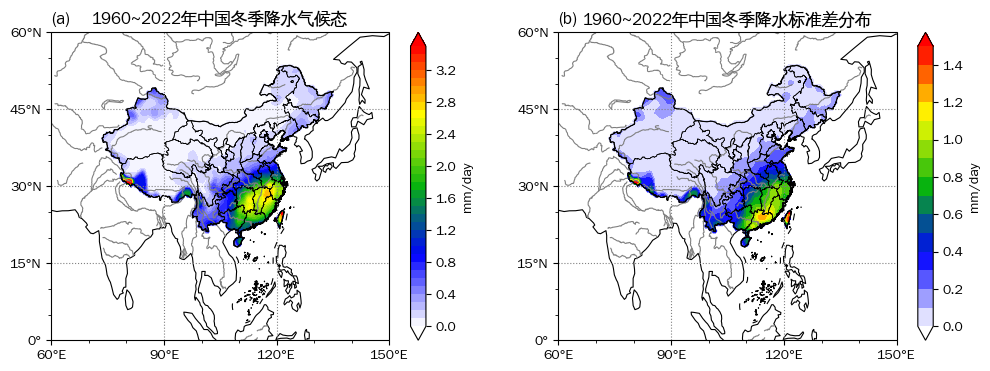

In [ ]:
# figsize=[20,8] default:6.4*4.8
fig = plt.figure(figsize=[12,4])
ax = fig.add_subplot(121,projection=ccrs.PlateCarree())
conset(ax)
# m = ax.contourf(lons, lats, prdc.mean('time'),projection=ccrs.PlateCarree(), 
#             cmap=cmaps.precip3_16lev, levels=np.arange(0,4.1,0.25), extend='both')
m = ax.contourf(lons, lats, prdc.mean('time'),projection=ccrs.PlateCarree(), 
            cmap=cmaps.wh_bl_gr_ye_re, levels=np.arange(0,3.6,0.1), extend='both')
ax.set_title("1960~2022年中国冬季降水气候态")
ax.set_title('(a)',loc='left')
cb = plt.colorbar(m)
cb.set_label('mm/day')

ax = fig.add_subplot(122,projection=ccrs.PlateCarree())
conset(ax)
m = ax.contourf(lons, lats, prdc.std('time'),projection=ccrs.PlateCarree(), 
            cmap=cmaps.wh_bl_gr_ye_re, levels=np.arange(0,1.51,0.1), extend='both')
ax.set_title("1960~2022年中国冬季降水标准差分布")
ax.set_title('(b)',loc='left')
cb = plt.colorbar(m)
cb.set_label('mm/day')

## 对中国冬季降水距平EOF

In [17]:
prdca = prdc - prdc.mean('time')
prdca_eof = scp.EOF(prdca)
prdca_eof.solve()
prdca_pc = prdca_eof.get_pc(npt=3)
prdca_pt = prdca_eof.get_pt(npt=3)
prdca_eof.get_varperc()

array([ 4.9812883e-01,  1.5780126e-01,  6.5263197e-02,  4.9295604e-02,
        3.9725073e-02,  2.6337849e-02,  2.1945279e-02,  1.7000718e-02,
        1.2382295e-02,  1.0822245e-02,  9.8959981e-03,  9.6022356e-03,
        7.9851747e-03,  6.2260753e-03,  5.3297854e-03,  4.6607642e-03,
        4.4205799e-03,  4.1407584e-03,  3.5988998e-03,  3.2359394e-03,
        3.0984359e-03,  2.9692939e-03,  2.6805601e-03,  2.3563744e-03,
        2.1710794e-03,  2.0457644e-03,  1.9312211e-03,  1.7491201e-03,
        1.6376262e-03,  1.5925409e-03,  1.4241179e-03,  1.3809481e-03,
        1.2510061e-03,  1.1909265e-03,  1.0921108e-03,  1.0466992e-03,
       -9.1407032e-10,  9.1210706e-04,  8.8547339e-04,  8.5793203e-04,
        7.8896806e-04,  1.2913630e-04,  1.5380238e-04,  1.7822643e-04,
        7.3337118e-04,  2.2195678e-04,  2.3013671e-04,  6.9073902e-04,
        6.6780951e-04,  2.6900705e-04,  2.8455065e-04,  2.9303975e-04,
        3.4613689e-04,  3.5463407e-04,  3.9010061e-04,  4.1272130e-04,
      

/usr/local/lib/python3.10/site-packages/cmaps/cmaps.py:6134: UserWarning: Overwriting the cmap 'precip_diff_12lev' that was already in the registry.
  matplotlib.cm.register_cmap(name=cname, cmap=cmap)
/usr/local/lib/python3.10/site-packages/cmaps/cmaps.py:6134: UserWarning: Overwriting the cmap 'precip_diff_12lev' that was already in the registry.
  matplotlib.cm.register_cmap(name=cname, cmap=cmap)


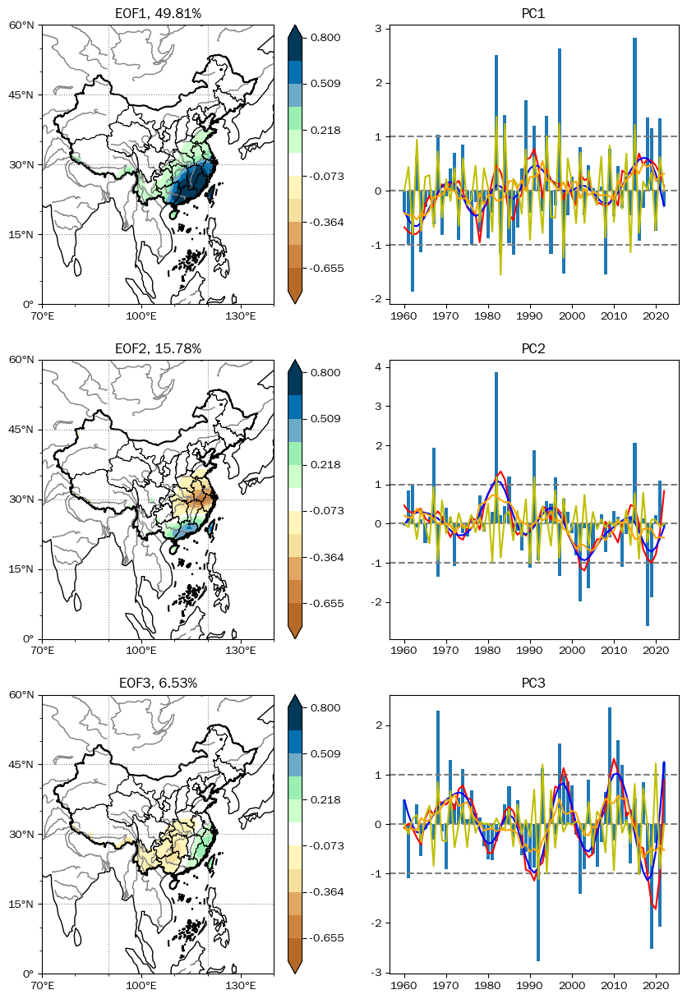

In [ ]:
fig = plt.figure(figsize=[12,15])
for i in range(3):
    ax = fig.add_subplot(3,2,2*i+1, projection=ccrs.PlateCarree())
    conset(ax)
    m = ax.contourf(prdc.lon,prdc.lat,-prdca_pt[i],transform=ccrs.PlateCarree(),
                cmap=cmaps.precip_diff_12lev, levels=np.linspace(-0.8,0.8,12), extend='both')
    cb = plt.colorbar(m)
    ax.set_title(f'EOF{i+1}, {prdca_eof.get_varperc()[i]:.2%}')
for i in range(3):
    ax = fig.add_subplot(3,2,2*i+2)
    ax.bar(prdca.time, -prdca_pc[i])
    ax.axhline(y=0, color='gray', linestyle='--')
    ax.axhline(y=1, color='gray', linestyle='--')
    ax.axhline(y=-1, color='gray', linestyle='--')
    ax.plot(prdc.time, signal.savgol_filter(-prdca_pc[i],9,3), color='red')
    # ax.plot(prdc.time, signal.detrend(-prdca_pc[i]), color='green')
    b, a = signal.butter(3, 0.2, 'lowpass') 
    ax.plot(prdc.time, signal.filtfilt(b, a, -prdca_pc[i]), c='b')
    b, a = signal.butter(3, 2/3, 'highpass') 
    ax.plot(prdc.time, signal.filtfilt(b, a, -prdca_pc[i]), c='y')
    ax.plot(prdc.time, np.convolve(-prdca_pc[i], np.repeat(1/9, 9), mode='same'),color='orange')
    ax.set_title(f'PC{i+1}')

/usr/local/lib/python3.10/site-packages/cmaps/cmaps.py:6134: UserWarning: Overwriting the cmap 'precip_diff_12lev' that was already in the registry.
  matplotlib.cm.register_cmap(name=cname, cmap=cmap)


Text(0.0, 1.0, '(b)')

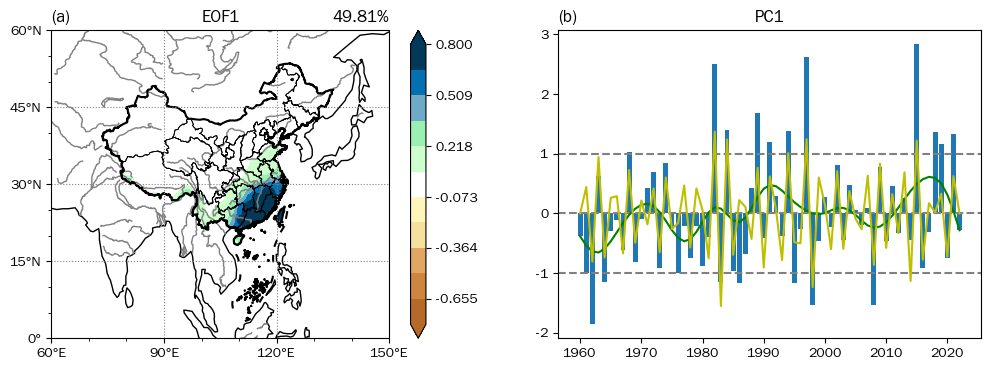

In [ ]:
fig = plt.figure(figsize=[12,4])
ax = fig.add_subplot(121, projection=ccrs.PlateCarree())
conset(ax)

m = ax.contourf(prdc.lon,prdc.lat,-prdca_pt[0],transform=ccrs.PlateCarree(),
                cmap=cmaps.precip_diff_12lev, levels=np.linspace(-0.8,0.8,12), extend='both')
cb = plt.colorbar(m)
ax.set_title(f'EOF{1}')
ax.set_title(f'{prdca_eof.get_varperc()[0]:.2%}',loc='right')
ax.set_title('(a)', loc='left')

ax = fig.add_subplot(122)
ax.bar(prdca.time, -prdca_pc[0])
ax.axhline(y=0, color='gray', linestyle='--')
ax.axhline(y=1, color='gray', linestyle='--')
ax.axhline(y=-1, color='gray', linestyle='--')
# ax.plot(prdc.time, signal.savgol_filter(-prdca_pc[0],9,3), color='red')
b, a = signal.butter(3, 0.2, 'lowpass') 
ax.plot(prdc.time, signal.filtfilt(b, a, -prdca_pc[0]), c='g')
b, a = signal.butter(3, 2/3, 'highpass') 
ax.plot(prdc.time, signal.filtfilt(b, a, -prdca_pc[0]), c='y')
ax.set_title(f'PC{1}')
ax.set_title('(b)', loc='left')

/usr/local/lib/python3.10/site-packages/cmaps/cmaps.py:7070: UserWarning: Overwriting the cmap 'wh_bl_gr_ye_re' that was already in the registry.
  matplotlib.cm.register_cmap(name=cname, cmap=cmap)
/usr/local/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1662: UserWarning: The following kwargs were not used by contour: 'projection'
  result = super().contourf(*args, **kwargs)
/usr/local/lib/python3.10/site-packages/cmaps/cmaps.py:7070: UserWarning: Overwriting the cmap 'wh_bl_gr_ye_re' that was already in the registry.
  matplotlib.cm.register_cmap(name=cname, cmap=cmap)
/usr/local/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1662: UserWarning: The following kwargs were not used by contour: 'projection'
  result = super().contourf(*args, **kwargs)
/usr/local/lib/python3.10/site-packages/cmaps/cmaps.py:6134: UserWarning: Overwriting the cmap 'precip_diff_12lev' that was already in the registry.
  matplotlib.cm.register_cmap(name=cname, cmap=cmap)


Text(0.0, 1.0, '(d)')

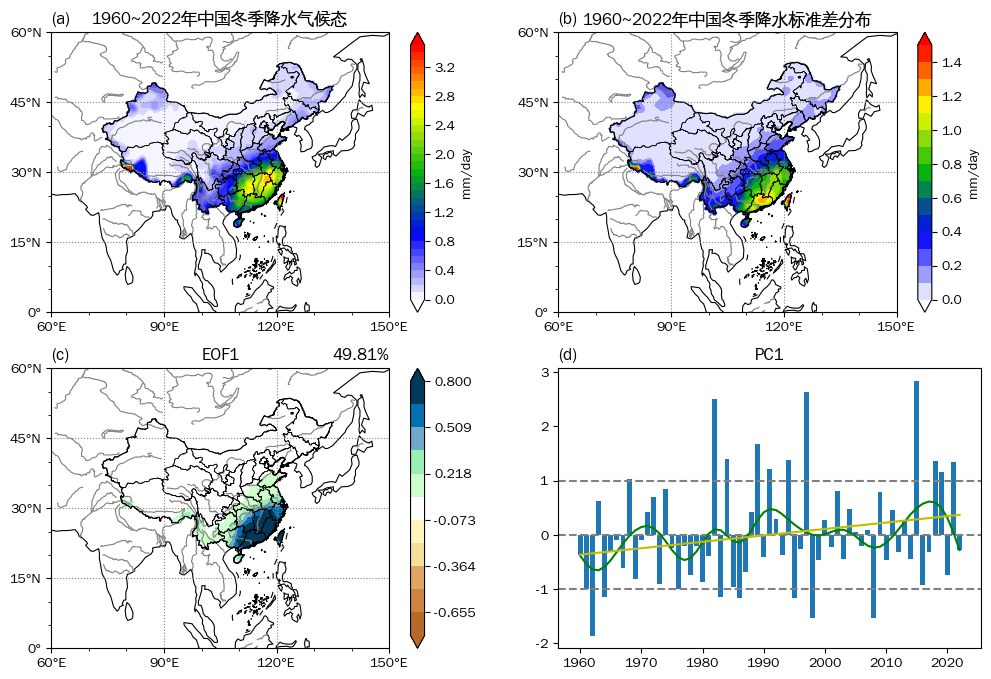

In [ ]:
fig = plt.figure(figsize=[12,8])

ax = fig.add_subplot(221,projection=ccrs.PlateCarree())
conset(ax)
# m = ax.contourf(lons, lats, prdc.mean('time'),projection=ccrs.PlateCarree(), 
#             cmap=cmaps.precip3_16lev, levels=np.arange(0,4.1,0.25), extend='both')
m = ax.contourf(lons, lats, prdc.mean('time'),projection=ccrs.PlateCarree(), 
            cmap=cmaps.wh_bl_gr_ye_re, levels=np.arange(0,3.6,0.1), extend='both')
ax.set_title("1960~2022年中国冬季降水气候态")
ax.set_title('(a)',loc='left')
cb = plt.colorbar(m)
cb.set_label('mm/day')

ax = fig.add_subplot(222,projection=ccrs.PlateCarree())
conset(ax)
m = ax.contourf(lons, lats, prdc.std('time'),projection=ccrs.PlateCarree(), 
            cmap=cmaps.wh_bl_gr_ye_re, levels=np.arange(0,1.51,0.1), extend='both')
ax.set_title("1960~2022年中国冬季降水标准差分布")
ax.set_title('(b)',loc='left')
cb = plt.colorbar(m)
cb.set_label('mm/day')

ax = fig.add_subplot(223, projection=ccrs.PlateCarree())
conset(ax)

m = ax.contourf(prdc.lon,prdc.lat,-prdca_pt[0],transform=ccrs.PlateCarree(),
                cmap=cmaps.precip_diff_12lev, levels=np.linspace(-0.8,0.8,12), extend='both')
cb = plt.colorbar(m)
ax.set_title(f'EOF{1}')
ax.set_title(f'{prdca_eof.get_varperc()[0]:.2%}',loc='right')
ax.set_title('(c)', loc='left')

ax = fig.add_subplot(224)
ax.bar(prdca.time, -prdca_pc[0])
ax.axhline(y=0, color='gray', linestyle='--')
ax.axhline(y=1, color='gray', linestyle='--')
ax.axhline(y=-1, color='gray', linestyle='--')
# ax.plot(prdc.time, signal.savgol_filter(-prdca_pc[0],9,3), color='red')
b, a = signal.butter(3, 0.2, 'lowpass') 
ax.plot(prdc.time, signal.filtfilt(b, a, -prdca_pc[0]), c='g')
# b, a = signal.butter(3, 2/3, 'highpass') 
# ax.plot(prdc.time, signal.filtfilt(b, a, -prdca_pc[0]), c='y')
slope, intercept = np.polyfit(prdc.time, -prdca_pc[0], 1)
linear_trend = slope * prdc.time + intercept
ax.plot(prdc.time,linear_trend,c='y')
ax.set_title(f'PC{1}')
ax.set_title('(d)', loc='left')

# 选区域

In [18]:
lons, lats = np.meshgrid(prd.lon, prd.lat)
prdcjnhn = jnhn.maskout(lons,lats,prd)
prdsc = ~(prdcjnhn.mask)*prd

## 对区域内降水距平百分率EOF

In [21]:
prdsc_ap = (prdsc-prdsc.mean('time'))/prdsc.mean('time')

prdsc_ap_eof = scp.EOF(prdsc_ap)
prdsc_ap_eof.solve()
prdsc_ap_pc = prdsc_ap_eof.get_pc(npt=3)
prdsc_ap_pt = prdsc_ap_eof.get_pt(npt=3)
prdsc_ap_eof.get_varperc()

array([ 6.67806208e-01,  1.24870561e-01,  7.17135146e-02,  3.59009802e-02,
        2.43807286e-02,  1.54804299e-02,  8.73579830e-03,  8.03394616e-03,
        6.13786606e-03,  5.36878360e-03,  4.37755836e-03,  3.62720597e-03,
        2.91041308e-03,  2.74139573e-03,  2.14628060e-03,  1.65050931e-03,
        1.50667899e-03,  1.36570330e-03,  1.16855814e-03,  1.05341023e-03,
        8.99433158e-04,  7.68621569e-04,  6.61386934e-04,  6.44955842e-04,
        5.87147370e-04,  5.32273902e-04,  4.90201579e-04,  4.66894067e-04,
        4.02557751e-04,  3.92468442e-04,  3.39608931e-04,  3.12996679e-04,
        2.65681039e-04,  2.44750874e-04,  2.46614363e-04,  1.93978791e-04,
        1.87207668e-04,  1.64422177e-04,  1.41139521e-04,  1.28941538e-04,
        1.22380239e-04,  1.09129323e-04,  8.98038779e-05,  7.82005081e-05,
        7.77202149e-05,  6.54733012e-05,  6.07706606e-05,  5.15341271e-05,
        5.26693730e-05,  4.24452955e-05,  3.39122744e-05,  3.10499381e-05,
       -3.33355943e-09,  

/usr/local/lib/python3.10/site-packages/cmaps/cmaps.py:6134: UserWarning: Overwriting the cmap 'precip_diff_12lev' that was already in the registry.
  matplotlib.cm.register_cmap(name=cname, cmap=cmap)
/usr/local/lib/python3.10/site-packages/cmaps/cmaps.py:6134: UserWarning: Overwriting the cmap 'precip_diff_12lev' that was already in the registry.
  matplotlib.cm.register_cmap(name=cname, cmap=cmap)


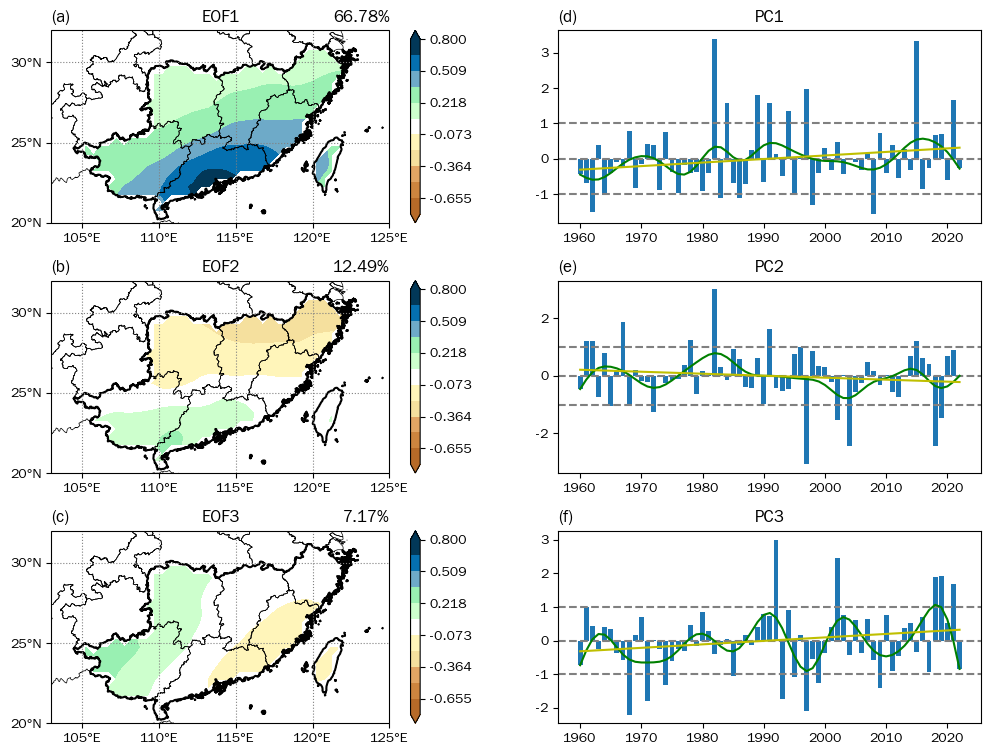

In [20]:
fig = plt.figure(figsize=[12,9])
fig.subplots_adjust(hspace=0.3)
for i in range(3):
    ax = fig.add_subplot(3,2,2*i+1, projection=ccrs.PlateCarree())
    conset1(ax)
    m = ax.contourf(prdsc.lon,prdsc.lat,-prdsc_ap_pt[i],transform=ccrs.PlateCarree(),
                cmap=cmaps.precip_diff_12lev, levels=np.linspace(-0.8,0.8,12), extend='both')
    cb = plt.colorbar(m)
    ax.set_title(f'EOF{i+1}')
    ax.set_title(f'{prdsc_ap_eof.get_varperc()[i]:.2%}',loc='right')
    ax.set_title(f'({chr(97 + i)})',loc='left')
for i in range(3):
    ax = fig.add_subplot(3,2,2*i+2)
    ax.bar(prdsc.time, -prdsc_ap_pc[i])
    ax.axhline(y=0, color='gray', linestyle='--')
    ax.axhline(y=1, color='gray', linestyle='--')
    ax.axhline(y=-1, color='gray', linestyle='--')
    # b, a = signal.butter(3, 2/3, 'highpass') 
    # ax.plot(prdsc.time, signal.filtfilt(b, a, -prdsc_ap_pc[i]), c='orange')
    b, a = signal.butter(3, 0.2, 'lowpass') 
    ax.plot(prdsc.time, signal.filtfilt(b, a, -prdsc_ap_pc[i]), c='g')
    # ax.plot(prdsc.time, signal.savgol_filter(-prdsc_ap_pc[i],9,3), color='red')
    slope, intercept = np.polyfit(prdsc.time, -prdsc_ap_pc[i], 1)
    linear_trend = slope * prdsc.time + intercept
    ax.plot(prdsc.time,linear_trend,c='y')
    ax.set_title(f'PC{i+1}')
    ax.set_title(f'({chr(100 + i)})', loc='left')

## 提取出PC1时间序列SCPC1

In [ ]:
time = np.array(np.arange(1960,2023),dtype=np.int64)
scpc1 = xr.DataArray(-prdsc_ap_pc[0],dims='time',coords=[time])

prdsc_hyr1 = scpc1[scpc1>1].time
prdsc_lyr1 = scpc1[scpc1<-1].time
prdsc_hyr1, prdsc_lyr1

(<xarray.DataArray 'time' (time: 8)>
 array([1982, 1984, 1989, 1991, 1994, 1997, 2015, 2021])
 Coordinates:
   * time     (time) int64 1982 1984 1989 1991 1994 1997 2015 2021,
 <xarray.DataArray 'time' (time: 7)>
 array([1962, 1964, 1983, 1986, 1995, 1998, 2008])
 Coordinates:
   * time     (time) int64 1962 1964 1983 1986 1995 1998 2008)

## 降水距平百分率区域平均标准化时间序列SCWPI

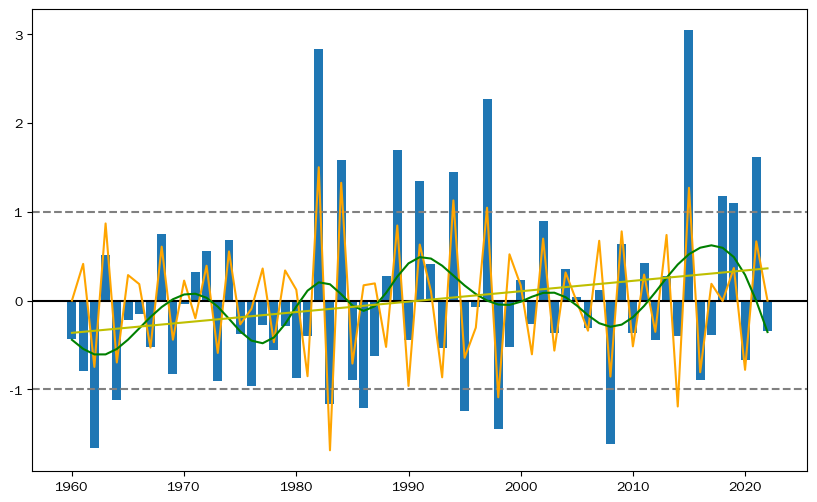

In [22]:
prdsc_apm = prdsc_ap.mean(('lon','lat'))
scwpi = prdsc_apm/prdsc_apm.std()

fig = plt.figure(figsize=[10,6])
ax = fig.add_subplot(111)
ax.bar(scwpi.time, scwpi)
ax.axhline(y=0, color='black', linestyle='-')
ax.axhline(y=1, color='gray', linestyle='--')
ax.axhline(y=-1, color='gray', linestyle='--')

b, a = signal.butter(3, 2/3, 'highpass') 
ax.plot(scwpi.time, signal.filtfilt(b, a, scwpi), c='orange')
b, a = signal.butter(3, 0.2, 'lowpass') 
ax.plot(scwpi.time, signal.filtfilt(b, a, scwpi), c='g')
slope, intercept = np.polyfit(scwpi.time, scwpi, 1)
linear_trend = slope * scwpi.time + intercept
ax.plot(scwpi.time, linear_trend, c='y')

In [ ]:
prdsc_hyr = scwpi[scwpi>1].time
prdsc_lyr = scwpi[scwpi<-1].time
prdsc_hyr, prdsc_lyr

(<xarray.DataArray 'time' (time: 10)>
 array([1982, 1984, 1989, 1991, 1994, 1997, 2015, 2018, 2019, 2021])
 Coordinates:
   * time     (time) int64 1982 1984 1989 1991 1994 1997 2015 2018 2019 2021,
 <xarray.DataArray 'time' (time: 7)>
 array([1962, 1964, 1983, 1986, 1995, 1998, 2008])
 Coordinates:
   * time     (time) int64 1962 1964 1983 1986 1995 1998 2008)

In [36]:
from scipy import stats
stats.pearsonr(scwpi,scpc1)

NameError: name 'scpc1' is not defined

In [ ]:
for i in range (5):
    print(f'({chr(97 + i)})')

(a)
(b)
(c)
(d)
(e)


In [ ]:
from string import ascii_lowercase
for i in range (5):
    print (ascii_lowercase [i])

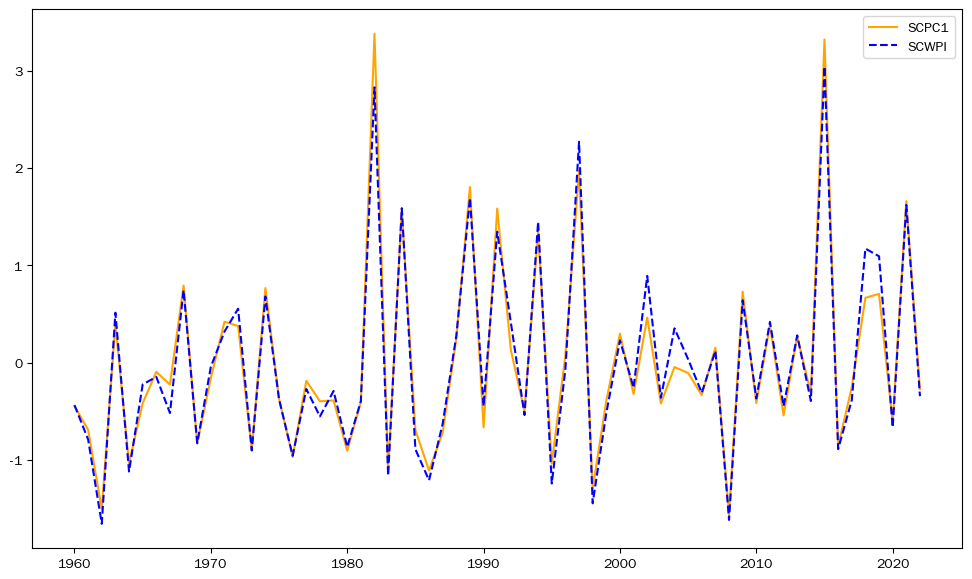

In [ ]:
plt.figure(figsize=[12,7])
plt.plot(scpc1.time, scpc1, color='orange', label='SCPC1')
plt.plot(scwpi.time, scwpi, 'b', linestyle='--', label='SCWPI')
plt.legend()

Text(0.0, 1.0, '(b)')

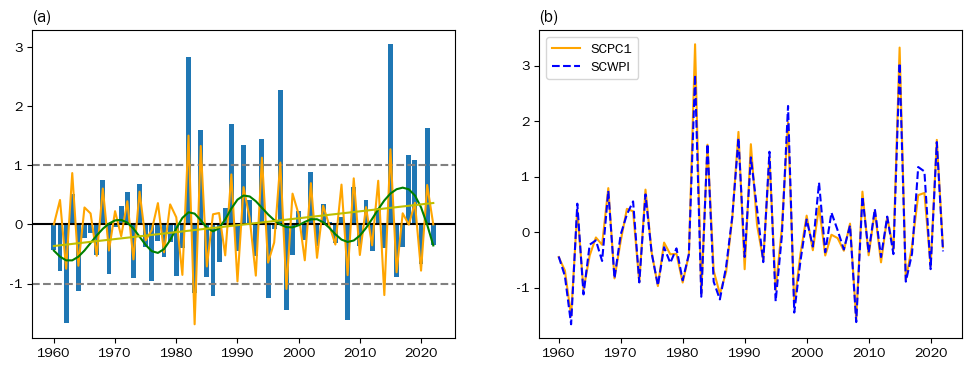

In [ ]:
fig = plt.figure(figsize=[12,4])

ax = fig.add_subplot(121)
ax.bar(scwpi.time, scwpi)
ax.axhline(y=0, color='black', linestyle='-')
ax.axhline(y=1, color='gray', linestyle='--')
ax.axhline(y=-1, color='gray', linestyle='--')
b, a = signal.butter(3, 2/3, 'highpass') 
ax.plot(scwpi.time, signal.filtfilt(b, a, scwpi), c='orange')
b, a = signal.butter(3, 0.2, 'lowpass') 
ax.plot(scwpi.time, signal.filtfilt(b, a, scwpi), c='g')
slope, intercept = np.polyfit(scwpi.time, scwpi, 1)
linear_trend = slope * scwpi.time + intercept
ax.plot(scwpi.time, linear_trend, c='y')
ax.set_title('(a)', loc='left')

ax = fig.add_subplot(122)
ax.plot(scpc1.time, scpc1, color='orange', label='SCPC1')
ax.plot(scwpi.time, scwpi, 'b', linestyle='--', label='SCWPI')
ax.legend()
ax.set_title('(b)', loc='left')

# todo: 

- [ ] 到底根据哪个选异常年？读文献……
- [ ] 200hPa急流、扰动流函数、波作用通量…… 
- [ ] 合成全球/其他区域的降水
- [x] 水汽单位
- [x] $\omega$, 上升运动

# 选关键年准备合成分析

## 用 SCWPI

In [ ]:
prdsc_hyr = scwpi[scwpi>1].time
prdsc_lyr = scwpi[scwpi<-1].time
prdsc_hyr, prdsc_lyr

(<xarray.DataArray 'time' (time: 10)>
 array([1982, 1984, 1989, 1991, 1994, 1997, 2015, 2018, 2019, 2021])
 Coordinates:
   * time     (time) int64 1982 1984 1989 1991 1994 1997 2015 2018 2019 2021,
 <xarray.DataArray 'time' (time: 7)>
 array([1962, 1964, 1983, 1986, 1995, 1998, 2008])
 Coordinates:
   * time     (time) int64 1962 1964 1983 1986 1995 1998 2008)

# 合成海平面气压

In [ ]:
slp = xr.open_dataset('slp.mon.mean.nc')['slp'].loc['1960':'2023']

slpd = scp.spec_moth_yrmean(slp, months=[12,1,2])

slpdhm = slpd[slpd.time.isin(prdsc_hyr)].mean('time')
slpdlm = slpd[slpd.time.isin(prdsc_lyr)].mean('time')

slpda = slpd - slpd.mean('time')

slpdah_m, slpdah_pv = scp.one_mean_test(slpda[slpda.time.isin(prdsc_hyr)])
slpdal_m, slpdal_pv = scp.one_mean_test(slpda[slpda.time.isin(prdsc_lyr)])

Text(0.0, 1.0, '(d)')

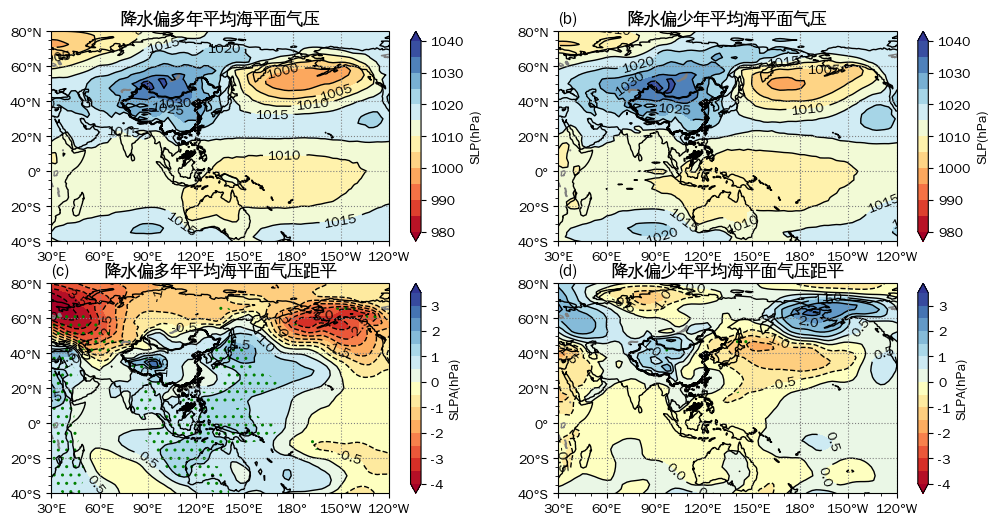

In [ ]:
fig = plt.figure(figsize=[12,6])
ax = fig.add_subplot(221, projection=ccrs.PlateCarree(central_longitude=180))
comset1(ax)
m = ax.contourf(slp.lon,slp.lat,slpdhm,transform=ccrs.PlateCarree(),
                cmap='RdYlBu',
                levels=np.arange(980,1041,5),extend='both'
               )
c = ax.contour(slp.lon,slp.lat,slpdhm,transform=ccrs.PlateCarree(),
               levels=np.arange(980,1041,5),
               colors='k',linewidths=1)
cb = plt.colorbar(m)
cb.set_label('SLP(hPa)')
ax.clabel(c)
ax.set_title('降水偏多年平均海平面气压')

ax = fig.add_subplot(222, projection=ccrs.PlateCarree(central_longitude=180))
comset1(ax)
m = ax.contourf(slp.lon,slp.lat,slpdlm,transform=ccrs.PlateCarree(),
                cmap='RdYlBu',
                levels=np.arange(980,1041,5),extend='both'
               )
c = ax.contour(slp.lon,slp.lat,slpdlm,transform=ccrs.PlateCarree(),
               levels=np.arange(980,1041,5),
               colors='k',linewidths=1)
cb = plt.colorbar(m)
cb.set_label('SLP(hPa)')
ax.clabel(c)
ax.set_title('降水偏少年平均海平面气压')
ax.set_title('(b)',loc='left')

ax = fig.add_subplot(223, projection=ccrs.PlateCarree(central_longitude=180))
comset1(ax)
# m = ax.contourf(slp.lon,slp.lat,slpdah_m,transform=ccrs.PlateCarree(), cmap='RdYlBu',levels=np.arange(-5,5.001,0.5),extend='both')
# c = ax.contour(slp.lon,slp.lat,slpdah_m,transform=ccrs.PlateCarree(),levels=np.arange(-5,5.001,0.5),colors='k',linewidths=1)
m = ax.contourf(slp.lon,slp.lat,slpdah_m,transform=ccrs.PlateCarree(), cmap='RdYlBu',levels=np.arange(-4,4.0,0.5),extend='both')
c = ax.contour(slp.lon,slp.lat,slpdah_m,transform=ccrs.PlateCarree(),levels=np.arange(-4,4.0,0.5),colors='k',linewidths=1)
cb = plt.colorbar(m)
cb.set_label('SLPA(hPa)')
ax.clabel(c)
ax.sig_plot(slp.lon,slp.lat,slpdah_pv, thrshd=0.05, marker='..', color='green')
ax.set_title('降水偏多年平均海平面气压距平')
ax.set_title('(c)',loc='left')

ax = fig.add_subplot(224, projection=ccrs.PlateCarree(central_longitude=180))
comset1(ax)
# m = ax.contourf(slp.lon,slp.lat,slpdal_m,transform=ccrs.PlateCarree(), cmap=cmaps.BlueWhiteOrangeRed_r,levels=np.arange(-4,4.001,0.5),extend='both')
m = ax.contourf(slp.lon,slp.lat,slpdal_m,transform=ccrs.PlateCarree(), cmap='RdYlBu',levels=np.arange(-4,4,0.5),extend='both')
c = ax.contour(slp.lon,slp.lat,slpdal_m,transform=ccrs.PlateCarree(),levels=np.arange(-4,4,0.5),colors='k',linewidths=1)
cb = plt.colorbar(m)
cb.set_label('SLPA(hPa)')
ax.clabel(c)
ax.sig_plot(slp.lon,slp.lat,slpdal_pv, thrshd=0.05, marker='..', color='green')
ax.set_title('降水偏少年平均海平面气压距平')
ax.set_title('(d)',loc='left')

fig.subplots_adjust(left=0.13,hspace=0.3)
cbar1_ax = fig.add_axes([0.93, 0.52, 0.01, 0.36])
cbar3_ax = fig.add_axes([0.93, 0.10, 0.01, 0.36])
cb1 = fig.colorbar(m1, cax=cbar1_ax)
cb3 = fig.colorbar(m3, cax=cbar3_ax)
cb1.set_label('纬向风 u200_mean (m/s)')
cb3.set_label('纬向风距平 u200_anomally (m/s)')

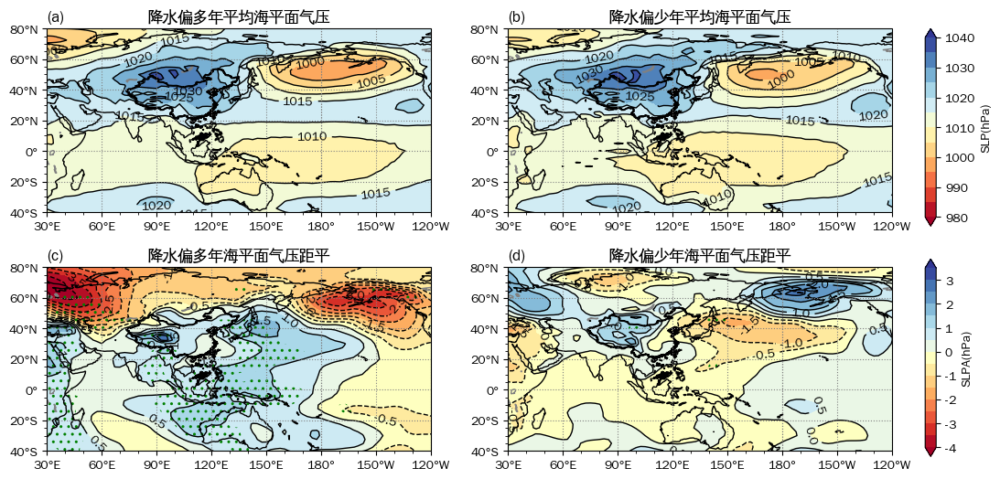

In [ ]:
fig = plt.figure(figsize=[12,6])
ax = fig.add_subplot(221, projection=ccrs.PlateCarree(central_longitude=180))
comset1(ax)
m1 = ax.contourf(slp.lon,slp.lat,slpdhm,transform=ccrs.PlateCarree(),
                cmap='RdYlBu',
                levels=np.arange(980,1041,5),extend='both'
               )
c1 = ax.contour(slp.lon,slp.lat,slpdhm,transform=ccrs.PlateCarree(),
               levels=np.arange(980,1041,5),
               colors='k',linewidths=1)

ax.clabel(c1)
ax.set_title('降水偏多年平均海平面气压')
ax.set_title('(a)',loc='left')

ax = fig.add_subplot(222, projection=ccrs.PlateCarree(central_longitude=180))
comset1(ax)
m1 = ax.contourf(slp.lon,slp.lat,slpdlm,transform=ccrs.PlateCarree(),
                cmap='RdYlBu',
                levels=np.arange(980,1041,5),extend='both'
               )
c1 = ax.contour(slp.lon,slp.lat,slpdlm,transform=ccrs.PlateCarree(),
               levels=np.arange(980,1041,5),
               colors='k',linewidths=1)

ax.clabel(c1)
ax.set_title('降水偏少年平均海平面气压')
ax.set_title('(b)',loc='left')

ax = fig.add_subplot(223, projection=ccrs.PlateCarree(central_longitude=180))
comset1(ax)
# m = ax.contourf(slp.lon,slp.lat,slpdah_m,transform=ccrs.PlateCarree(), cmap='RdYlBu',levels=np.arange(-5,5.001,0.5),extend='both')
# c = ax.contour(slp.lon,slp.lat,slpdah_m,transform=ccrs.PlateCarree(),levels=np.arange(-5,5.001,0.5),colors='k',linewidths=1)
m3 = ax.contourf(slp.lon,slp.lat,slpdah_m,transform=ccrs.PlateCarree(), cmap='RdYlBu',levels=np.arange(-4,4.0,0.5),extend='both')
c3 = ax.contour(slp.lon,slp.lat,slpdah_m,transform=ccrs.PlateCarree(),levels=np.arange(-4,4.0,0.5),colors='k',linewidths=1)

ax.clabel(c3)
ax.sig_plot(slp.lon,slp.lat,slpdah_pv, thrshd=0.05, marker='..', color='green')
ax.set_title('降水偏多年海平面气压距平')
ax.set_title('(c)',loc='left')

ax = fig.add_subplot(224, projection=ccrs.PlateCarree(central_longitude=180))
comset1(ax)
# m = ax.contourf(slp.lon,slp.lat,slpdal_m,transform=ccrs.PlateCarree(), cmap=cmaps.BlueWhiteOrangeRed_r,levels=np.arange(-4,4.001,0.5),extend='both')
m3 = ax.contourf(slp.lon,slp.lat,slpdal_m,transform=ccrs.PlateCarree(), cmap='RdYlBu',levels=np.arange(-4,4,0.5),extend='both')
c3 = ax.contour(slp.lon,slp.lat,slpdal_m,transform=ccrs.PlateCarree(),levels=np.arange(-4,4,0.5),colors='k',linewidths=1)

ax.clabel(c3)
ax.sig_plot(slp.lon,slp.lat,slpdal_pv, thrshd=0.05, marker='..', color='green')
ax.set_title('降水偏少年海平面气压距平')
ax.set_title('(d)',loc='left')

fig.subplots_adjust(left=0.13,hspace=0.3)
cbar1_ax = fig.add_axes([0.93, 0.52, 0.01, 0.36])
cbar3_ax = fig.add_axes([0.93, 0.10, 0.01, 0.36])
cb1 = fig.colorbar(m1, cax=cbar1_ax)
cb3 = fig.colorbar(m3, cax=cbar3_ax)
cb1.set_label('SLP(hPa)')
cb3.set_label('SLPA(hPa)')

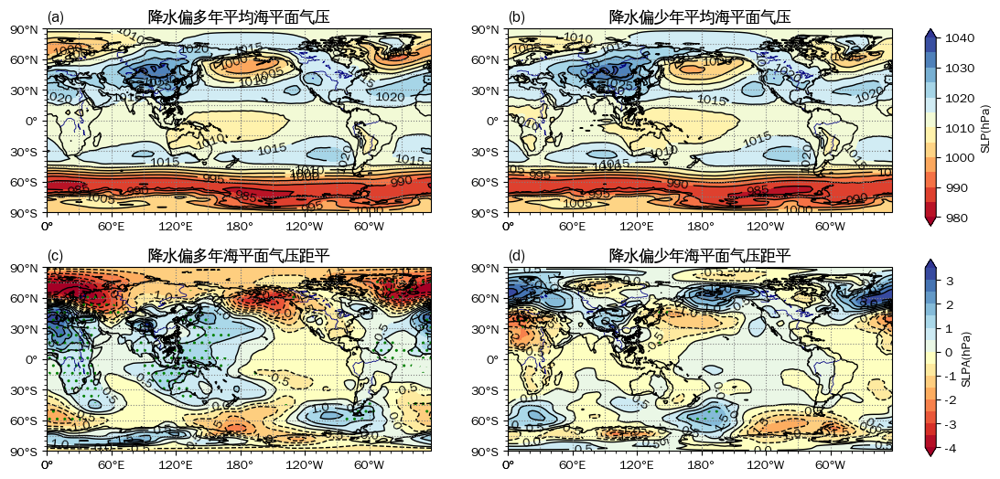

In [ ]:
fig = plt.figure(figsize=[12,6])
ax = fig.add_subplot(221, projection=ccrs.PlateCarree(central_longitude=180))
comset(ax)
m1 = ax.contourf(slp.lon,slp.lat,slpdhm,transform=ccrs.PlateCarree(),
                cmap='RdYlBu',
                levels=np.arange(980,1041,5),extend='both'
               )
c1 = ax.contour(slp.lon,slp.lat,slpdhm,transform=ccrs.PlateCarree(),
               levels=np.arange(980,1041,5),
               colors='k',linewidths=1)

ax.clabel(c1)
ax.set_title('降水偏多年平均海平面气压')
ax.set_title('(a)',loc='left')

ax = fig.add_subplot(222, projection=ccrs.PlateCarree(central_longitude=180))
comset(ax)
m1 = ax.contourf(slp.lon,slp.lat,slpdlm,transform=ccrs.PlateCarree(),
                cmap='RdYlBu',
                levels=np.arange(980,1041,5),extend='both'
               )
c1 = ax.contour(slp.lon,slp.lat,slpdlm,transform=ccrs.PlateCarree(),
               levels=np.arange(980,1041,5),
               colors='k',linewidths=1)

ax.clabel(c1)
ax.set_title('降水偏少年平均海平面气压')
ax.set_title('(b)',loc='left')

ax = fig.add_subplot(223, projection=ccrs.PlateCarree(central_longitude=180))
comset(ax)
# m = ax.contourf(slp.lon,slp.lat,slpdah_m,transform=ccrs.PlateCarree(), cmap='RdYlBu',levels=np.arange(-5,5.001,0.5),extend='both')
# c = ax.contour(slp.lon,slp.lat,slpdah_m,transform=ccrs.PlateCarree(),levels=np.arange(-5,5.001,0.5),colors='k',linewidths=1)
m3 = ax.contourf(slp.lon,slp.lat,slpdah_m,transform=ccrs.PlateCarree(), cmap='RdYlBu',levels=np.arange(-4,4.0,0.5),extend='both')
c3 = ax.contour(slp.lon,slp.lat,slpdah_m,transform=ccrs.PlateCarree(),levels=np.arange(-4,4.0,0.5),colors='k',linewidths=1)

ax.clabel(c3)
ax.sig_plot(slp.lon,slp.lat,slpdah_pv, thrshd=0.05, marker='..', color='green')
ax.set_title('降水偏多年海平面气压距平')
ax.set_title('(c)',loc='left')

ax = fig.add_subplot(224, projection=ccrs.PlateCarree(central_longitude=180))
comset(ax)
# m = ax.contourf(slp.lon,slp.lat,slpdal_m,transform=ccrs.PlateCarree(), cmap=cmaps.BlueWhiteOrangeRed_r,levels=np.arange(-4,4.001,0.5),extend='both')
m3 = ax.contourf(slp.lon,slp.lat,slpdal_m,transform=ccrs.PlateCarree(), cmap='RdYlBu',levels=np.arange(-4,4,0.5),extend='both')
c3 = ax.contour(slp.lon,slp.lat,slpdal_m,transform=ccrs.PlateCarree(),levels=np.arange(-4,4,0.5),colors='k',linewidths=1)

ax.clabel(c3)
ax.sig_plot(slp.lon,slp.lat,slpdal_pv, thrshd=0.05, marker='..', color='green')
ax.set_title('降水偏少年海平面气压距平')
ax.set_title('(d)',loc='left')

fig.subplots_adjust(left=0.13,hspace=0.3)
cbar1_ax = fig.add_axes([0.93, 0.52, 0.01, 0.36])
cbar3_ax = fig.add_axes([0.93, 0.10, 0.01, 0.36])
cb1 = fig.colorbar(m1, cax=cbar1_ax)
cb3 = fig.colorbar(m3, cax=cbar3_ax)
cb1.set_label('SLP(hPa)')
cb3.set_label('SLPA(hPa)')

# 合成500hPa

In [ ]:
h500 = xr.open_dataset('hgt.mon.mean.nc')['hgt'].loc['1960':'2023',500]

h500d = scp.spec_moth_yrmean(h500, months=[12,1,2])

h500dhm = h500d[h500d.time.isin(prdsc_hyr1)].mean('time')
h500dlm = h500d[h500d.time.isin(prdsc_lyr1)].mean('time')

h500da = h500d - h500d.mean('time')

h500dah_m, h500dah_pv = scp.one_mean_test(h500da[h500da.time.isin(prdsc_hyr)])
h500dal_m, h500dal_pv = scp.one_mean_test(h500da[h500da.time.isin(prdsc_lyr)])

/usr/local/lib/python3.10/site-packages/cmaps/cmaps.py:440: UserWarning: Overwriting the cmap 'BlueWhiteOrangeRed' that was already in the registry.
  matplotlib.cm.register_cmap(name=cname, cmap=cmap)


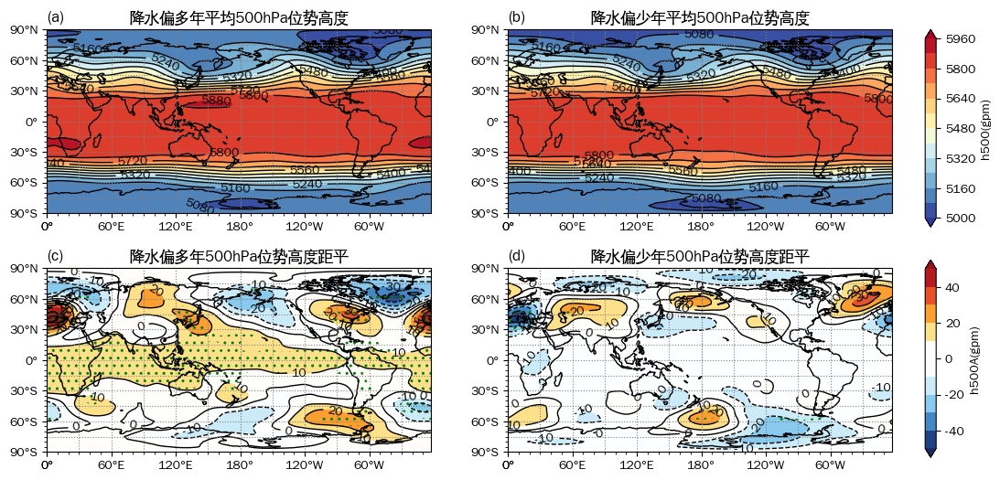

In [ ]:
fig = plt.figure(figsize=[12,6])
ax = fig.add_subplot(221, projection=ccrs.PlateCarree(central_longitude=180))
comset(ax)
m1 = ax.contourf(h500.lon,h500.lat,h500dhm,transform=ccrs.PlateCarree(),
                cmap='RdYlBu_r',
                levels=np.arange(5000,6000,80),extend='both'
               )
c1 = ax.contour(h500.lon,h500.lat,h500dhm,transform=ccrs.PlateCarree(),
               levels=np.arange(5000,6000,80),
               colors='k',linewidths=1)
ax.clabel(c1)

ax.set_title('降水偏多年平均500hPa位势高度')
ax.set_title('(a)',loc='left')

ax = fig.add_subplot(222, projection=ccrs.PlateCarree(central_longitude=180))
comset(ax)
m1 = ax.contourf(h500.lon,h500.lat,h500dlm,transform=ccrs.PlateCarree(),
                cmap='RdYlBu_r',
                levels=np.arange(5000,6000,80),extend='both'
               )
c1 = ax.contour(h500.lon,h500.lat,h500dlm,transform=ccrs.PlateCarree(),
               levels=np.arange(5000,6000,80),
               colors='k',linewidths=1)
ax.clabel(c1)

ax.set_title('降水偏少年平均500hPa位势高度')
ax.set_title('(b)',loc='left')

ax = fig.add_subplot(223, projection=ccrs.PlateCarree(central_longitude=180))
comset(ax)
m3 = ax.contourf(h500.lon,h500.lat,h500dah_m,transform=ccrs.PlateCarree(), cmap=cmaps.BlueWhiteOrangeRed,levels=np.arange(-50,51,10),extend='both')
c3 = ax.contour(h500.lon,h500.lat,h500dah_m,transform=ccrs.PlateCarree(),levels=np.arange(-50,51,10),colors='k',linewidths=1)
ax.clabel(c3)

ax.sig_plot(h500.lon,h500.lat,h500dah_pv, thrshd=0.05, marker='..', color='green')
ax.set_title('降水偏多年500hPa位势高度距平')
ax.set_title('(c)',loc='left')

ax = fig.add_subplot(224, projection=ccrs.PlateCarree(central_longitude=180))
comset(ax)
m3 = ax.contourf(h500.lon,h500.lat,h500dal_m,transform=ccrs.PlateCarree(), cmap=cmaps.BlueWhiteOrangeRed,levels=np.arange(-50,51,10),extend='both')
c3 = ax.contour(h500.lon,h500.lat,h500dal_m,transform=ccrs.PlateCarree(),levels=np.arange(-50,51,10),colors='k',linewidths=1)
ax.clabel(c3)

ax.sig_plot(h500.lon,h500.lat,h500dal_pv, thrshd=0.05, marker='..', color='green')
ax.set_title('降水偏少年500hPa位势高度距平')
ax.set_title('(d)',loc='left')

fig.subplots_adjust(left=0.13,hspace=0.3)
cbar1_ax = fig.add_axes([0.93, 0.52, 0.01, 0.36])
cbar3_ax = fig.add_axes([0.93, 0.10, 0.01, 0.36])
cb1 = fig.colorbar(m1, cax=cbar1_ax)
cb3 = fig.colorbar(m3, cax=cbar3_ax)
cb1.set_label('h500(gpm)')
cb3.set_label('h500A(gpm)')

# 合成水汽相关量 - Moisture Flux (Divergence)

In [ ]:
# q_
xr.open_dataset('shum.mon.mean.nc')

<xarray.Dataset>
Dimensions:  (level: 8, lat: 73, lon: 144, time: 903)
Coordinates:
  * level    (level) float32 1e+03 925.0 850.0 700.0 600.0 500.0 400.0 300.0
  * lat      (lat) float32 90.0 87.5 85.0 82.5 80.0 ... -82.5 -85.0 -87.5 -90.0
  * lon      (lon) float32 0.0 2.5 5.0 7.5 10.0 ... 350.0 352.5 355.0 357.5
  * time     (time) datetime64[ns] 1948-01-01 1948-02-01 ... 2023-03-01
Data variables:
    shum     (time, level, lat, lon) float32 ...
Attributes:
    description:    Data is from NMC initialized reanalysis\n(4x/day).  It co...
    platform:       Model
    Conventions:    COARDS
    NCO:            20121012
    history:        Mon Jul  5 22:28:55 1999: ncrcat shum.mon.mean.nc /Datase...
    title:          monthly mean shum from the NCEP Reanalysis
    dataset_title:  NCEP-NCAR Reanalysis 1
    References:     http://www.psl.noaa.gov/data/gridded/data.ncep.reanalysis...

In [ ]:
xr.open_dataset('uwnd.mon.mean.nc')

<xarray.Dataset>
Dimensions:  (level: 17, lat: 73, lon: 144, time: 903)
Coordinates:
  * level    (level) float32 1e+03 925.0 850.0 700.0 ... 50.0 30.0 20.0 10.0
  * lat      (lat) float32 90.0 87.5 85.0 82.5 80.0 ... -82.5 -85.0 -87.5 -90.0
  * lon      (lon) float32 0.0 2.5 5.0 7.5 10.0 ... 350.0 352.5 355.0 357.5
  * time     (time) datetime64[ns] 1948-01-01 1948-02-01 ... 2023-03-01
Data variables:
    uwnd     (time, level, lat, lon) float32 ...
Attributes:
    title:          monthly mean u wind from the NCEP Reanalysis
    description:    Data from NCEP initialized reanalysis (4x/day).  These ar...
    platform:       Model
    Conventions:    COARDS
    NCO:            20121012
    history:        Mon Jul  5 22:36:33 1999: ncrcat uwnd.mon.mean.nc /Datase...
    dataset_title:  NCEP-NCAR Reanalysis 1
    References:     http://www.psl.noaa.gov/data/gridded/data.ncep.reanalysis...

In [ ]:
q_ = xr.open_dataset('shum.mon.mean.nc')['shum'].loc[{'time':slice('1960','2023'), 'level':slice(300,1000,-1)}]
u_ = xr.open_dataset('uwnd.mon.mean.nc')['uwnd'].loc[{'time':slice('1960','2023'), 'level':slice(300,1000,-1)}]
v_ = xr.open_dataset('vwnd.mon.mean.nc')['vwnd'].loc[{'time':slice('1960','2023'), 'level':slice(300,1000,-1)}]

In [ ]:
q_.max(), q_.min(), q_.mean(), q_.median(), q_.valid_range, q_.quantile([0,0.25,0.5,0.75,1])

/usr/local/lib/python3.10/site-packages/numpy/lib/function_base.py:4527: RuntimeWarning: invalid value encountered in subtract
  diff_b_a = subtract(b, a)


(<xarray.DataArray 'shum' ()>
 array(inf),
 <xarray.DataArray 'shum' ()>
 array(0.),
 <xarray.DataArray 'shum' ()>
 array(inf, dtype=float32),
 <xarray.DataArray 'shum' ()>
 array(1.20899963),
 array([-9.999999e-02,  1.004300e+02], dtype=float32),
 <xarray.DataArray 'shum' (quantile: 5)>
 array([0.        , 0.32899857, 1.20899963, 3.84000015,        nan])
 Coordinates:
   * quantile  (quantile) float64 0.0 0.25 0.5 0.75 1.0)

In [ ]:
q_test = xr.where(np.abs(q_)>100,np.nan,q_)

In [ ]:
q_test.max(), q_test.min(), q_test.mean(), q_test.median(), q_test.quantile([0,0.25,0.5,0.75,1])

(<xarray.DataArray 'shum' ()>
 array(41.43870544),
 <xarray.DataArray 'shum' ()>
 array(0.),
 <xarray.DataArray 'shum' ()>
 array(2.9668007, dtype=float32),
 <xarray.DataArray 'shum' ()>
 array(1.20787907),
 <xarray.DataArray 'shum' (quantile: 5)>
 array([ 0.        ,  0.32899857,  1.20787901,  3.83150011, 41.43870544])
 Coordinates:
   * quantile  (quantile) float64 0.0 0.25 0.5 0.75 1.0)

In [ ]:
qd = scp.spec_moth_yrmean(q_test, months=[12,1,2])*units('g/kg')
ud = scp.spec_moth_yrmean(u_, months=[12,1,2])*units('m/s')
vd = scp.spec_moth_yrmean(v_, months=[12,1,2])*units('m/s')
# qd.attrs['units'] = 'g/kg'
# ud.attrs['units'] = 'm/s'
# vd.attrs['units'] = 'm/s'
# qd = qd.metpy.quantify()
# ud = ud.metpy.quantify()
# vd = vd.metpy.quantify()

In [ ]:
f'{constants.g}', f'{qd.metpy.units}'

('9.80665 meter / second ** 2', 'gram / kilogram')

**`metpy.grid_deltas_from_dataarray()` vs `mpcalc.lat_lon_grid_deltas()`, `metpy.grid_deltas_from_dataarray()`更接近实际 & 更方便用，`mpcalc.lat_lon_grid_deltas()`把地球看作了理想球体 & 要加上`dx = dx[None,None,:]`处理维度不对应的问题**

In [ ]:
# import metpy
dx,dy = metpy.grid_deltas_from_dataarray(qd)
# dy
# div_test2 = mpcalc.divergence(qud,qvd,dx=dx,dy=dy)
np.quantile(dx.magnitude,[0,0.25,0.5,0.75,1]), np.quantile(dy.magnitude,[0,0.25,0.5,0.75,1])

(array([     0.        , 106798.6623232 , 197109.26868292, 257237.63519969,
        278298.72698318]),
 array([-279233.15815816, -278799.09925668, -277829.45842783,
        -276865.40773639, -276437.45050798]))

In [ ]:
dx, dy = mpcalc.lat_lon_grid_deltas(qd.lon, qd.lat)
# dx, dy
# dx = dx[None,None,:]
np.quantile(dx.magnitude,[0,0.25,0.5,0.75,1]), np.quantile(dy.magnitude,[0,0.25,0.5,0.75,1])

(array([     0.        , 106373.8872405 , 196558.82688545, 256823.68708875,
        277987.1857117 ]),
 array([-277987.1857117, -277987.1857117, -277987.1857117, -277987.1857117,
        -277987.1857117]))

In [ ]:
# dx, dy = mpcalc.lat_lon_grid_deltas(qd.lon, qd.lat)
# dx = dx[None,None,:]
# dy = dy[None,None,:]
# qud = (ud*qd/constants.g)
# qvd = (vd*qd/constants.g)
# qdivd = mpcalc.divergence(qud,qvd,dx=dx,dy=dy)
# # qdivd = xr.zeros_like(qd)
# # for i in range(qd.shape[0]):
# #     for j in range(qd.shape[1]):
# #         qdivd[i,j] = mpcalc.divergence(qud[i,j],qvd[i,j],dx=dx ,dy=dy)

# # # 计算整层水汽通量散度
# # total_qdivd = qdivd.integrate('level')

# # # 计算整层水汽通量
# # total_qud = qud.integrate('level')
# # total_qvd = qvd.integrate('level')
# # total_quvd = np.sqrt(total_qud ** 2 + total_qvd ** 2)

/usr/local/lib/python3.10/site-packages/pint/facets/plain/quantity.py:1119: RuntimeWarning: invalid value encountered in divide
  magnitude = magnitude_op(new_self._magnitude, other._magnitude)


In [ ]:
import metpy
dx,dy = metpy.grid_deltas_from_dataarray(qd)
qud = (ud*qd/constants.g)
qvd = (vd*qd/constants.g)
qdivd = mpcalc.divergence(qud,qvd,dx=dx,dy=dy)

# 计算整层水汽通量散度
total_qdivd = qdivd.integrate('level')*units('hPa')
total_qdivd = total_qdivd.metpy.convert_to_base_units()

# 计算整层水汽通量
total_qud = qud.integrate('level')*units('hPa')
total_qvd = qvd.integrate('level')*units('hPa')
total_quvd = np.sqrt(total_qud ** 2 + total_qvd ** 2)
total_quvd = total_quvd.metpy.convert_to_base_units()

/usr/local/lib/python3.10/site-packages/pint/facets/plain/quantity.py:1119: RuntimeWarning: invalid value encountered in divide
  magnitude = magnitude_op(new_self._magnitude, other._magnitude)


In [ ]:
total_qdivd.quantile([0,0.25,0.5,0.75,1]), total_quvd.quantile([0,0.25,0.5,0.75,1])

(<xarray.DataArray (quantile: 5)>
 <Quantity([-2.26152308e-01 -2.69864199e-05 -1.66924618e-07  2.66378090e-05
   2.20665127e-01], 'kilogram / meter ** 2 / second')>
 Coordinates:
   * quantile  (quantile) float64 0.0 0.25 0.5 0.75 1.0,
 <xarray.DataArray (quantile: 5)>
 <Quantity([2.90710721e-02 1.90919333e+01 6.26163731e+01 1.50957870e+02
  5.10270966e+02], 'kilogram / meter / second')>
 Coordinates:
   * quantile  (quantile) float64 0.0 0.25 0.5 0.75 1.0)

In [ ]:
# t_qdivda = total_qdivd - total_qdivd.mean('time')
# t_qdivdah_m, t_qdivdah_pv = scp.one_mean_test(t_qdivda[t_qdivda.time.isin(prdsc_hyr)])
# t_qdivdal_m, t_qdivdal_pv = scp.one_mean_test(t_qdivda[t_qdivda.time.isin(prdsc_lyr)])
# t_quda = total_qud - total_qud.mean('time')
# t_qudah_m, t_qudah_pv = scp.one_mean_test(t_quda[t_quda.time.isin(prdsc_hyr)])
# t_qudal_m, t_qudal_pv = scp.one_mean_test(t_quda[t_quda.time.isin(prdsc_lyr)])
# t_qvda = total_qvd - total_qvd.mean('time')
# t_qvdah_m, t_qvdah_pv = scp.one_mean_test(t_qvda[t_qvda.time.isin(prdsc_hyr)])
# t_qvdal_m, t_qvdal_pv = scp.one_mean_test(t_qvda[t_qvda.time.isin(prdsc_lyr)])
# t_quvda = total_quvd - total_quvd.mean('time')
# t_quvdah_m, t_quvdah_pv = scp.one_mean_test(t_quvda[t_quvda.time.isin(prdsc_hyr)])
# t_quvdal_m, t_quvdal_pv = scp.one_mean_test(t_quvda[t_quvda.time.isin(prdsc_lyr)])

In [ ]:
t_qdivda = total_qdivd - total_qdivd.mean('time')
t_qdivda_hm = t_qdivda[t_qdivda.time.isin(prdsc_hyr)].mean('time')
t_qdivda_lm = t_qdivda[t_qdivda.time.isin(prdsc_lyr)].mean('time')
t_quda = total_qud - total_qud.mean('time')
t_quda_hm = t_quda[t_quda.time.isin(prdsc_hyr)].mean('time')
t_quda_lm = t_quda[t_quda.time.isin(prdsc_lyr)].mean('time')
t_qvda = total_qvd - total_qvd.mean('time')
t_qvda_hm = t_qvda[t_qvda.time.isin(prdsc_hyr)].mean('time')
t_qvda_lm = t_qvda[t_qvda.time.isin(prdsc_lyr)].mean('time')
t_quvda = total_quvd - total_quvd.mean('time')
t_quvda_hm = t_quvda[t_quvda.time.isin(prdsc_hyr)].mean('time')
t_quvda_lm = t_quvda[t_quvda.time.isin(prdsc_lyr)].mean('time')

In [ ]:
f'{t_qdivda_hm.metpy.units}',f'{total_qdivd.metpy.units}',f'{total_quvd.metpy.units}',f'{qdivd.metpy.units}',f'{qud.metpy.units}'

('kilogram / meter ** 2 / second',
 'kilogram / meter ** 2 / second',
 'kilogram / meter / second',
 'gram * second / kilogram / meter',
 'gram * second / kilogram')

In [ ]:
# from scipy.stats.mstats import ttest_ind
t_qdivda_hm.quantile([0,0.25,0.5,0.75,1])

Magnitude,[-0.020503867226746762 -5.695533435664489e-06 1.5126148142906223e-07 5.844586080060545e-06 0.0124739432429686]
Units,kilogram/(meter2 second)


/usr/local/lib/python3.10/site-packages/cartopy/crs.py:529: UserWarning: Some vectors at source domain corners may not have been transformed correctly
  warnings.warn('Some vectors at source domain corners '


Text(0.5, 1.0, 'Moisture Flux (div) Anomaly Mean in PRSC low years')

/usr/local/lib/python3.10/site-packages/cartopy/io/__init__.py:241: DownloadWarning: Downloading: https://naturalearth.s3.amazonaws.com/50m_physical/ne_50m_coastline.zip
  warnings.warn(f'Downloading: {url}', DownloadWarning)
/usr/local/lib/python3.10/site-packages/cartopy/io/__init__.py:241: DownloadWarning: Downloading: https://naturalearth.s3.amazonaws.com/50m_physical/ne_50m_rivers_lake_centerlines.zip
  warnings.warn(f'Downloading: {url}', DownloadWarning)


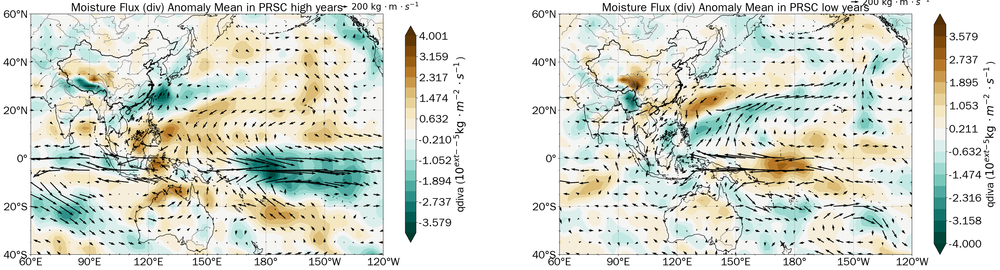

In [ ]:
# fig = plt.figure(figsize=[40,10])
# # ax = fig.add_subplot(121, projection=ccrs.PlateCarree(central_longitude=180))
# ax = fig.add_subplot(121, projection=ccrs.PlateCarree(central_longitude=120))
# comset2(ax)
# m = ax.contourf(qd.lon,qd.lat,t_qdivda_hm*10**5,transform=ccrs.PlateCarree(), 
#                 cmap='BrBG_r', levels=np.linspace(-4,4.001,20),extend='both')
# q = ax.quiver(qd.lon[::2],qd.lat[::2],t_quda_hm[::2,::2].to_numpy(),t_qvda_hm[::2,::2].to_numpy(),transform=ccrs.PlateCarree(),
#             color='k')
# cb = plt.colorbar(m, shrink=0.9)
# cb.set_label('qdiva ($10^{-5} \operatorname{kg} \cdot \operatorname{m^{-2}} \cdot \operatorname{s^{-1}}$)')
# ax.quiverkey(q, 0.85, 1.02, 200, '$200\ \operatorname{kg} \cdot \operatorname{m^{-1}} \cdot \operatorname{s^{-1}}$', labelpos='E',fontproperties={'size':20})
# ax.set_title('Moisture Flux (div) Anomaly Mean in PRSC high years')

# ax = fig.add_subplot(122, projection=ccrs.PlateCarree())
# comset2(ax)
# m = ax.contourf(qd.lon,qd.lat,t_qdivda_lm*10**5,transform=ccrs.PlateCarree(), 
#                 cmap='BrBG_r', levels=np.linspace(-4,4.0001,20),extend='both')
# q = ax.quiver(qd.lon[::2],qd.lat[::2],t_quda_lm[::2,::2].to_numpy(),t_qvda_lm[::2,::2].to_numpy(),transform=ccrs.PlateCarree(),
#             color='k')
# cb = plt.colorbar(m)
# cb.set_label('qdiva ($10^{-5} \operatorname{kg} \cdot \operatorname{m^{-2}} \cdot \operatorname{s^{-1}}$)')
# ax.quiverkey(q, 0.85, 1.02, 200, '$200\ \operatorname{kg} \cdot \operatorname{m^{-1}} \cdot \operatorname{s^{-1}}$', labelpos='E',fontproperties={'size':20})
# # ax.contourf(q850.lon,q850.lat,np.maximum(qu850dal_pv,qv850dal_pv),transform=ccrs.PlateCarree(), 
#             # levels=[0,0.05,0.15,1],colors=['grey','silver',(0,0,0,0)],zorder=1)
# ax.set_title('Moisture Flux (div) Anomaly Mean in PRSC low years')

/usr/local/lib/python3.10/site-packages/cartopy/crs.py:529: UserWarning: Some vectors at source domain corners may not have been transformed correctly
  warnings.warn('Some vectors at source domain corners '


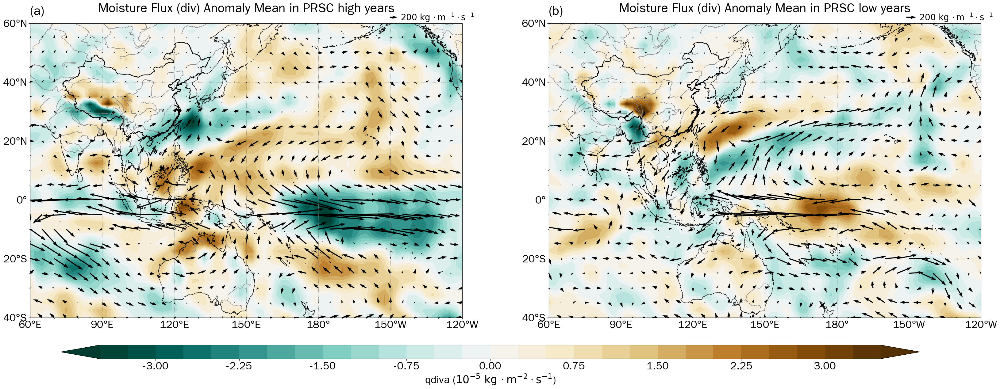

In [ ]:
fig = plt.figure(figsize=[40,15])
ax = fig.add_subplot(121, projection=ccrs.PlateCarree(central_longitude=180))
# ax = fig.add_subplot(121, projection=ccrs.PlateCarree(central_longitude=120))
comset2(ax)
# m = ax.contourf(qd.lon,qd.lat,t_qdivda_hm*10**5,transform=ccrs.PlateCarree(), 
#                 cmap='BrBG_r', levels=np.linspace(-4,4.001,20),extend='both')
m = ax.contourf(qd.lon,qd.lat,t_qdivda_hm*10**5,transform=ccrs.PlateCarree(), 
                cmap='BrBG_r', levels=np.arange(-3.5,3.5001,0.25),extend='both')
q = ax.quiver(qd.lon[::2],qd.lat[::2],t_quda_hm[::2,::2].to_numpy(),t_qvda_hm[::2,::2].to_numpy(),transform=ccrs.PlateCarree(),
            color='k')
# cb = plt.colorbar(m, shrink=0.9)
# cb.set_label('qdiva ($10^{-5} \operatorname{kg} \cdot \operatorname{m^{-2}} \cdot \operatorname{s^{-1}}$)')
ax.quiverkey(q, 0.85, 1.02, 200, '$200\ \operatorname{kg} \cdot \mathrm{m^{-1}} \cdot \mathrm{s^{-1}}$', labelpos='E',fontproperties={'size':20})
ax.set_title('Moisture Flux (div) Anomaly Mean in PRSC high years',fontsize=30, y=1.03)
ax.set_title('(a)',loc='left',y=1.02,fontsize=30)

ax = fig.add_subplot(122, projection=ccrs.PlateCarree(central_longitude=180))
comset2(ax)
m = ax.contourf(qd.lon,qd.lat,t_qdivda_lm*10**5,transform=ccrs.PlateCarree(), 
                cmap='BrBG_r', levels=np.arange(-3.5,3.5001,0.25),extend='both')
q = ax.quiver(qd.lon[::2],qd.lat[::2],t_quda_lm[::2,::2].to_numpy(),t_qvda_lm[::2,::2].to_numpy(),transform=ccrs.PlateCarree(),
            color='k')
# cb = plt.colorbar(m)
# cb.set_label('qdiva ($10^{-5} \operatorname{kg} \cdot \operatorname{m^{-2}} \cdot \operatorname{s^{-1}}$)')
ax.quiverkey(q, 0.85, 1.02, 200, '$200\ \operatorname{kg} \cdot \mathrm{m^{-1}} \cdot \mathrm{s^{-1}}$', labelpos='E',fontproperties={'size':20})
# ax.contourf(q850.lon,q850.lat,np.maximum(qu850dal_pv,qv850dal_pv),transform=ccrs.PlateCarree(), 
            # levels=[0,0.05,0.15,1],colors=['grey','silver',(0,0,0,0)],zorder=1)
ax.set_title('Moisture Flux (div) Anomaly Mean in PRSC low years',fontsize=30, y=1.03)
ax.set_title('(b)',loc='left',y=1.02,fontsize=30)
fig.subplots_adjust(bottom=0.24)
cbar_ax = fig.add_axes([0.15, 0.15, 0.7, 0.03])
cb = fig.colorbar(m, cax=cbar_ax, orientation='horizontal')
cb.set_label('qdiva ($10^{-5}\ \operatorname{kg} \cdot \mathrm{m^{-2}} \cdot \mathrm{s^{-1}}$)')

/usr/local/lib/python3.10/site-packages/cartopy/crs.py:529: UserWarning: Some vectors at source domain corners may not have been transformed correctly
  warnings.warn('Some vectors at source domain corners '


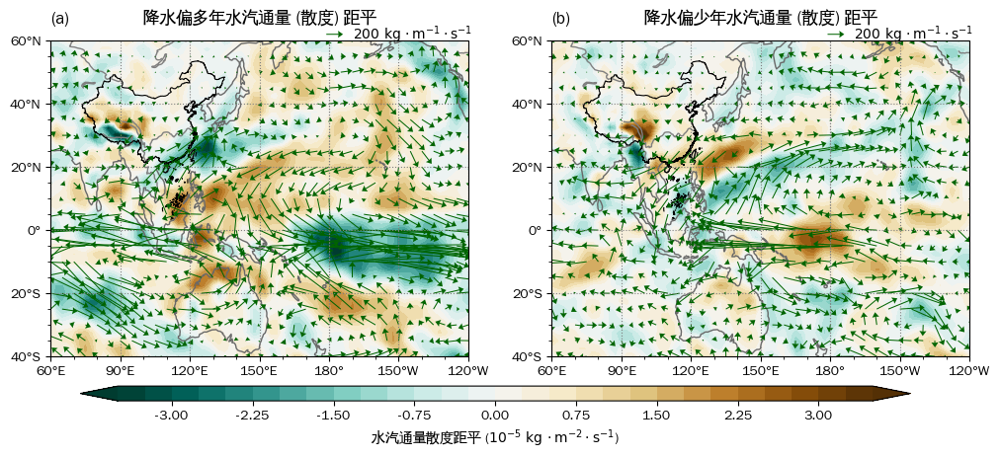

In [ ]:
fig = plt.figure(figsize=[12,5])
ax = fig.add_subplot(121, projection=ccrs.PlateCarree(central_longitude=180))
# ax = fig.add_subplot(121, projection=ccrs.PlateCarree(central_longitude=120))
comset2(ax)
# m = ax.contourf(qd.lon,qd.lat,t_qdivda_hm*10**5,transform=ccrs.PlateCarree(), 
#                 cmap='BrBG_r', levels=np.linspace(-4,4.001,20),extend='both')
m = ax.contourf(qd.lon,qd.lat,t_qdivda_hm*10**5,transform=ccrs.PlateCarree(), 
                cmap='BrBG_r', levels=np.arange(-3.5,3.5001,0.25),extend='both')
q = ax.quiver(qd.lon[::2],qd.lat[::2],t_quda_hm[::2,::2].to_numpy(),t_qvda_hm[::2,::2].to_numpy(),transform=ccrs.PlateCarree(),
            color='darkgreen', scale=5000,headwidth=7, zorder=2)
# cb = plt.colorbar(m, shrink=0.9)
# cb.set_label('qdiva ($10^{-5} \operatorname{kg} \cdot \operatorname{m^{-2}} \cdot \operatorname{s^{-1}}$)')
ax.quiverkey(q, 0.7, 1.02, 200, '$200\ \operatorname{kg} \cdot \mathrm{m^{-1}} \cdot \mathrm{s^{-1}}$', labelpos='E')
ax.set_title('降水偏多年水汽通量 (散度) 距平', y=1.03)
ax.set_title('(a)',loc='left',y=1.03)

ax = fig.add_subplot(122, projection=ccrs.PlateCarree(central_longitude=180))
comset2(ax)
m = ax.contourf(qd.lon,qd.lat,t_qdivda_lm*10**5,transform=ccrs.PlateCarree(), 
                cmap='BrBG_r', levels=np.arange(-3.5,3.5001,0.25),extend='both')
q = ax.quiver(qd.lon[::2],qd.lat[::2],t_quda_lm[::2,::2].to_numpy(),t_qvda_lm[::2,::2].to_numpy(),transform=ccrs.PlateCarree(),
            color='darkgreen', scale=5000,headwidth=7, zorder=2)
# cb = plt.colorbar(m)
# cb.set_label('qdiva ($10^{-5} \operatorname{kg} \cdot \operatorname{m^{-2}} \cdot \operatorname{s^{-1}}$)')
ax.quiverkey(q, 0.7, 1.02, 200, '$200\ \operatorname{kg} \cdot \mathrm{m^{-1}} \cdot \mathrm{s^{-1}}$', labelpos='E')
# ax.contourf(q850.lon,q850.lat,np.maximum(qu850dal_pv,qv850dal_pv),transform=ccrs.PlateCarree(), 
            # levels=[0,0.05,0.15,1],colors=['grey','silver',(0,0,0,0)],zorder=1)
ax.set_title('降水偏少年水汽通量 (散度) 距平', y=1.03)
ax.set_title('(b)',loc='left',y=1.03)

fig.subplots_adjust(bottom=0.24)
cbar_ax = fig.add_axes([0.15, 0.15, 0.7, 0.03])
cb = fig.colorbar(m, cax=cbar_ax, orientation='horizontal')
cb.set_label('水汽通量散度距平 ($10^{-5}\ \operatorname{kg} \cdot \mathrm{m^{-2}} \cdot \mathrm{s^{-1}}$)')

# 合成 / 回归海温SST

In [ ]:
xr.open_dataset('sst.mnmean.nc')

<xarray.Dataset>
Dimensions:    (lat: 89, lon: 180, time: 2031, nbnds: 2)
Coordinates:
  * lat        (lat) float32 88.0 86.0 84.0 82.0 ... -82.0 -84.0 -86.0 -88.0
  * lon        (lon) float32 0.0 2.0 4.0 6.0 8.0 ... 352.0 354.0 356.0 358.0
  * time       (time) datetime64[ns] 1854-01-01 1854-02-01 ... 2023-03-01
Dimensions without coordinates: nbnds
Data variables:
    time_bnds  (time, nbnds) float64 ...
    sst        (time, lat, lon) float32 ...
Attributes: (12/37)
    climatology:               Climatology is based on 1971-2000 SST, Xue, Y....
    description:               In situ data: ICOADS2.5 before 2007 and NCEP i...
    keywords_vocabulary:       NASA Global Change Master Directory (GCMD) Sci...
    keywords:                  Earth Science > Oceans > Ocean Temperature > S...
    instrument:                Conventional thermometers
    source_comment:            SSTs were observed by conventional thermometer...
    ...                        ...
    creator_url_original:      https://www.ncei.noaa.gov
    license:                   No constraints on data access or use
    comment:                   SSTs were observed by conventional thermometer...
    summary:                   ERSST.v5 is developed based on v4 after revisi...
    dataset_title:             NOAA Extended Reconstructed SST V5
    data_modified:             2023-04-04

In [ ]:
# def htmean(x):
#     return x[x.time.isin(prdsc_hyr)].mean('time')

In [25]:
sst = xr.open_dataset('sst.mnmean.nc')['sst'].loc[{'time':slice('1960','2023')}]
sstd = scp.spec_moth_yrmean(sst,months=[12,1,2])
sstdm = sstd.mean('time')
sstda = sstd - sstdm
sstd_hm = sstd[sstd.time.isin(prdsc_hyr)].mean('time')
sstd_lm = sstd[sstd.time.isin(prdsc_lyr)].mean('time')
sstda_hm, sstda_hp = scp.one_mean_test(sstda[sstda.time.isin(prdsc_hyr)])
sstda_lm, sstda_lp = scp.one_mean_test(sstda[sstda.time.isin(prdsc_lyr)])

/usr/local/lib/python3.10/site-packages/scipy/stats/_axis_nan_policy.py:554: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  return result_to_tuple(hypotest_fun_out(*samples, **kwds))


In [ ]:
import matplotlib as mpl

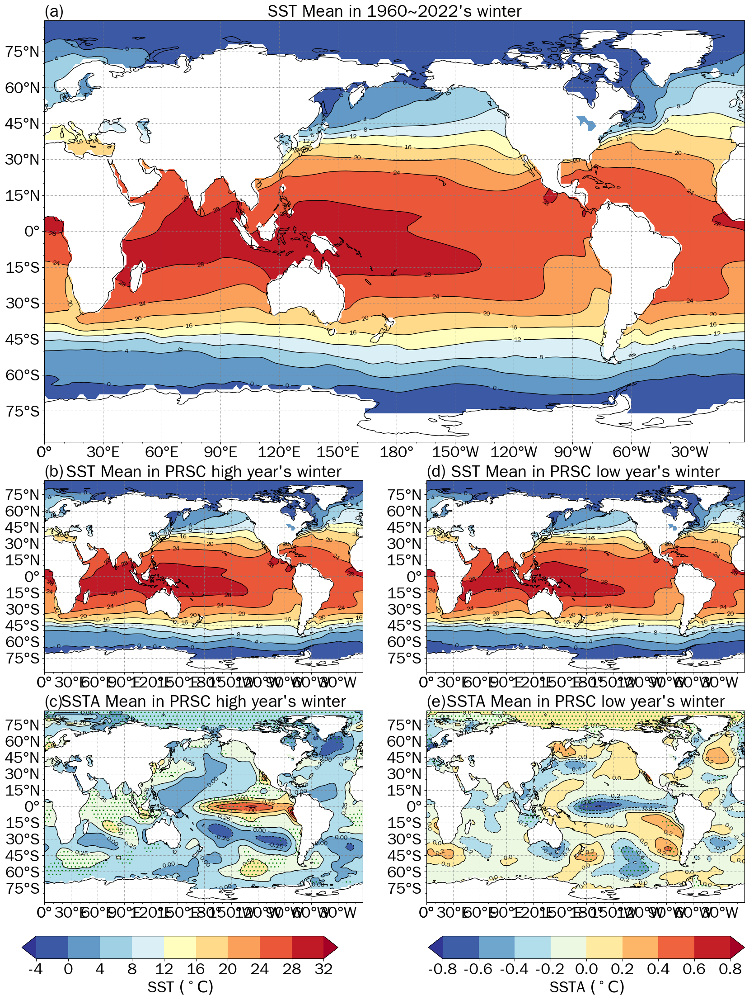

In [ ]:
fig = plt.figure(figsize=[20,25])
# gs = mpl.gridspec.GridSpec(3,2)
gs = plt.GridSpec(4,2)
ax0 = fig.add_subplot(gs[0:2,:], projection=ccrs.PlateCarree(central_longitude=180))
comset(ax0)
m = ax0.contourf(sst.lon,sst.lat,sstdm,transform=ccrs.PlateCarree(),
                cmap='RdYlBu_r',
                # levels=np.arange(980,1040,5),extend='both'
               )
c = ax0.contour(sst.lon,sst.lat,sstdm,transform=ccrs.PlateCarree(),
            #    levels=np.arange(980,1040,5),
               colors='k',linewidths=1)
ax0.clabel(c)
ax0.set_title('SST Mean in 1960~2022\'s winter')
ax0.set_title('(a)',loc='left')

ax1 = fig.add_subplot(gs[2,0], projection=ccrs.PlateCarree(central_longitude=180))
comset(ax1)
m = ax1.contourf(sst.lon,sst.lat,sstd_hm,transform=ccrs.PlateCarree(),
                cmap='RdYlBu_r',
                # levels=np.arange(980,1040,5),extend='both'
               )
c = ax1.contour(sst.lon,sst.lat,sstd_hm,transform=ccrs.PlateCarree(),
            #    levels=np.arange(980,1040,5),
               colors='k',linewidths=1)
ax1.clabel(c)
ax1.set_title('SST Mean in PRSC high year\'s winter')
ax1.set_title('(b)',loc='left')

ax2 = fig.add_subplot(gs[3,0], projection=ccrs.PlateCarree(central_longitude=180))
comset(ax2)
m1 = ax2.contourf(sst.lon,sst.lat,sstda_hm,transform=ccrs.PlateCarree(),
                cmap='RdYlBu_r',
                # levels=np.arange(980,1040,5),extend='both'
               )
c1 = ax2.contour(sst.lon,sst.lat,sstda_hm,transform=ccrs.PlateCarree(),
            #    levels=np.arange(980,1040,5),
               colors='k',linewidths=1)
ax2.clabel(c1)
ax2.sig_plot(sst.lon,sst.lat,sstda_hp, thrshd=0.05, marker='..', color='green')
ax2.set_title('SSTA Mean in PRSC high year\'s winter')
ax2.set_title('(c)',loc='left')

ax3 = fig.add_subplot(gs[2,1], projection=ccrs.PlateCarree(central_longitude=180))
comset(ax3)
m = ax3.contourf(sst.lon,sst.lat,sstd_lm,transform=ccrs.PlateCarree(),
                cmap='RdYlBu_r',
                levels=np.arange(-4,32.01,4),extend='both'
               )
c = ax3.contour(sst.lon,sst.lat,sstd_lm,transform=ccrs.PlateCarree(),
               levels=np.arange(-4,32.01,4),
               colors='k',linewidths=1)
ax3.clabel(c)
ax3.set_title('SST Mean in PRSC low year\'s winter')
ax3.set_title('(d)',loc='left')

ax4 = fig.add_subplot(gs[3,1], projection=ccrs.PlateCarree(central_longitude=180))
comset(ax4)
m1 = ax4.contourf(sst.lon,sst.lat,sstda_lm,transform=ccrs.PlateCarree(),
                cmap='RdYlBu_r',
                levels=np.arange(-0.8,0.801,0.2),extend='both'
               )
c1 = ax4.contour(sst.lon,sst.lat,sstda_lm,transform=ccrs.PlateCarree(),
               levels=np.arange(-0.8,0.801,0.2),
               colors='k',linewidths=1)
ax4.clabel(c1)
ax4.sig_plot(sst.lon,sst.lat,sstda_lp, thrshd=0.05, marker='..', color='green')
ax4.set_title('SSTA Mean in PRSC low year\'s winter')
ax4.set_title('(e)',loc='left')

fig.subplots_adjust(bottom=0.10)
cbar_ax = fig.add_axes([0.10, 0.05, 0.35, 0.02])
cbar1_ax = fig.add_axes([0.55, 0.05, 0.35, 0.02])
cb = fig.colorbar(m, cax=cbar_ax, orientation='horizontal')
cb1 = fig.colorbar(m1, cax=cbar1_ax, orientation='horizontal')
cb.set_label('SST $(^\circ \mathrm{C})$')
cb1.set_label('SSTA $(^\circ \mathrm{C})$')

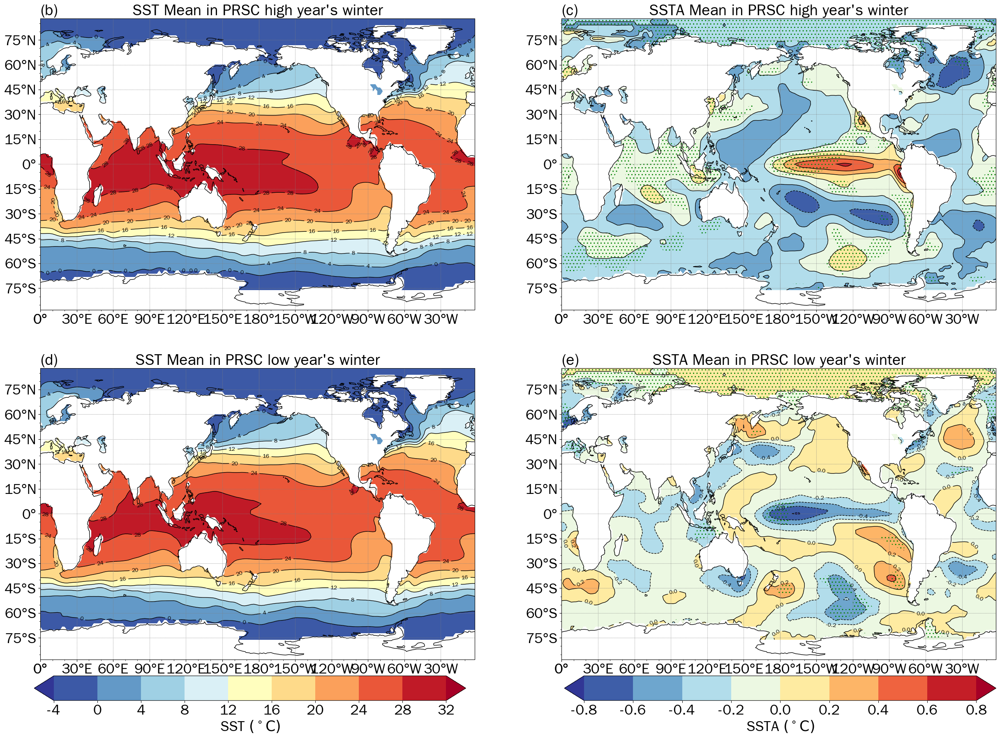

In [ ]:
fig = plt.figure(figsize=[30,20])
ax1 = fig.add_subplot(221, projection=ccrs.PlateCarree(central_longitude=180))
comset(ax1)
m = ax1.contourf(sst.lon,sst.lat,sstd_hm,transform=ccrs.PlateCarree(),
                cmap='RdYlBu_r',
                # levels=np.arange(980,1040,5),extend='both'
               )
c = ax1.contour(sst.lon,sst.lat,sstd_hm,transform=ccrs.PlateCarree(),
            #    levels=np.arange(980,1040,5),
               colors='k',linewidths=1)
ax1.clabel(c)
ax1.set_title('SST Mean in PRSC high year\'s winter')
ax1.set_title('(b)',loc='left')

ax2 = fig.add_subplot(222, projection=ccrs.PlateCarree(central_longitude=180))
comset(ax2)
m1 = ax2.contourf(sst.lon,sst.lat,sstda_hm,transform=ccrs.PlateCarree(),
                cmap='RdYlBu_r',
                # levels=np.arange(980,1040,5),extend='both'
               )
c1 = ax2.contour(sst.lon,sst.lat,sstda_hm,transform=ccrs.PlateCarree(),
            #    levels=np.arange(980,1040,5),
               colors='k',linewidths=1)
ax2.clabel(c)
ax2.sig_plot(sst.lon,sst.lat,sstda_hp, thrshd=0.05, marker='..', color='green')
ax2.set_title('SSTA Mean in PRSC high year\'s winter')
ax2.set_title('(c)',loc='left')

ax3 = fig.add_subplot(223, projection=ccrs.PlateCarree(central_longitude=180))
comset(ax3)
m = ax3.contourf(sst.lon,sst.lat,sstd_lm,transform=ccrs.PlateCarree(),
                cmap='RdYlBu_r',
                levels=np.arange(-4,32.01,4),extend='both'
               )
c = ax3.contour(sst.lon,sst.lat,sstd_lm,transform=ccrs.PlateCarree(),
               levels=np.arange(-4,32.01,4),
               colors='k',linewidths=1)
ax3.clabel(c)
ax3.set_title('SST Mean in PRSC low year\'s winter')
ax3.set_title('(d)',loc='left')

ax4 = fig.add_subplot(224, projection=ccrs.PlateCarree(central_longitude=180))
comset(ax4)
m1 = ax4.contourf(sst.lon,sst.lat,sstda_lm,transform=ccrs.PlateCarree(),
                cmap='RdYlBu_r',
                levels=np.arange(-0.8,0.801,0.2),extend='both'
               )
c1 = ax4.contour(sst.lon,sst.lat,sstda_lm,transform=ccrs.PlateCarree(),
               levels=np.arange(-0.8,0.801,0.2),
               colors='k',linewidths=1)
ax4.clabel(c1)
ax4.sig_plot(sst.lon,sst.lat,sstda_lp, thrshd=0.05, marker='..', color='green')
ax4.set_title('SSTA Mean in PRSC low year\'s winter')
ax4.set_title('(e)',loc='left')

fig.subplots_adjust(bottom=0.10)
cbar_ax = fig.add_axes([0.12, 0.05, 0.35, 0.03])
cbar1_ax = fig.add_axes([0.55, 0.05, 0.35, 0.03])
cb = fig.colorbar(m, cax=cbar_ax, orientation='horizontal')
cb1 = fig.colorbar(m1, cax=cbar1_ax, orientation='horizontal')
cb.set_label('SST $(^\circ \mathrm{C})$')
cb1.set_label('SSTA $(^\circ \mathrm{C})$')

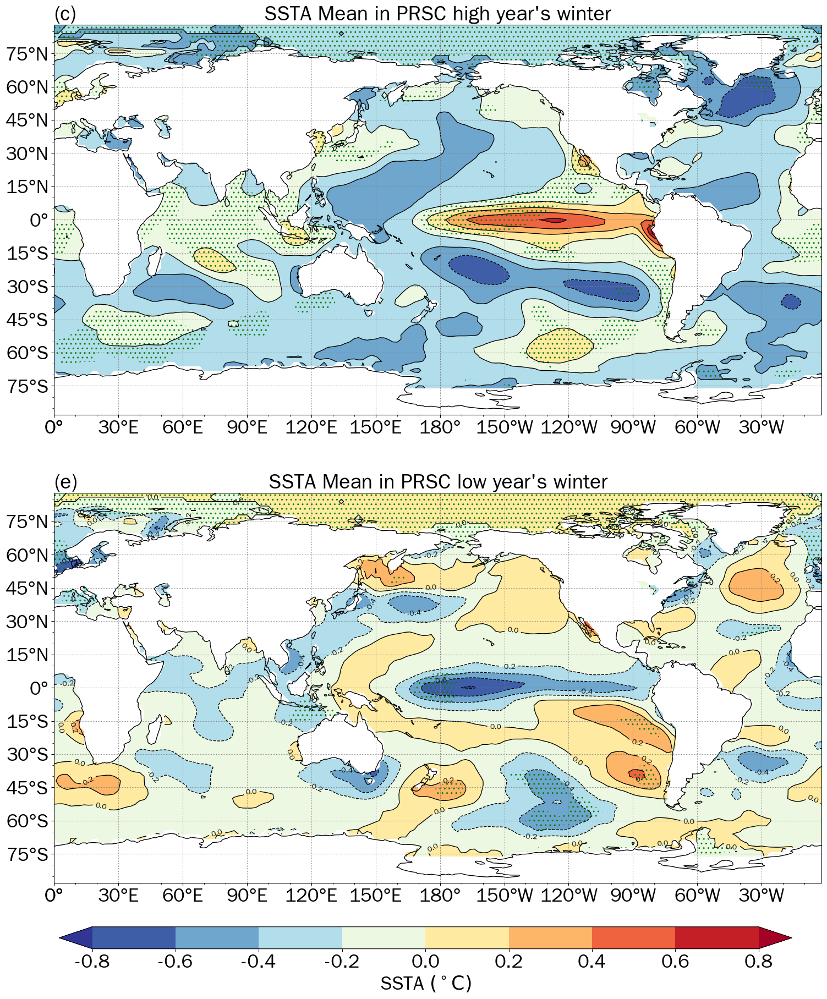

In [ ]:
fig = plt.figure(figsize=[18,20])

ax2 = fig.add_subplot(211, projection=ccrs.PlateCarree(central_longitude=180))
comset(ax2)
m1 = ax2.contourf(sst.lon,sst.lat,sstda_hm,transform=ccrs.PlateCarree(),
                cmap='RdYlBu_r',
                # levels=np.arange(980,1040,5),extend='both'
               )
c1 = ax2.contour(sst.lon,sst.lat,sstda_hm,transform=ccrs.PlateCarree(),
            #    levels=np.arange(980,1040,5),
               colors='k',linewidths=1)
ax2.clabel(c1)
ax2.sig_plot(sst.lon,sst.lat,sstda_hp, thrshd=0.05, marker='..', color='green')
ax2.set_title('SSTA Mean in PRSC high year\'s winter')
ax2.set_title('(c)',loc='left')

ax4 = fig.add_subplot(212, projection=ccrs.PlateCarree(central_longitude=180))
comset(ax4)
m1 = ax4.contourf(sst.lon,sst.lat,sstda_lm,transform=ccrs.PlateCarree(),
                cmap='RdYlBu_r',
                levels=np.arange(-0.8,0.801,0.2),extend='both'
               )
c1 = ax4.contour(sst.lon,sst.lat,sstda_lm,transform=ccrs.PlateCarree(),
               levels=np.arange(-0.8,0.801,0.2),
               colors='k',linewidths=1)
ax4.clabel(c1)
ax4.sig_plot(sst.lon,sst.lat,sstda_lp, thrshd=0.05, marker='..', color='green')
ax4.set_title('SSTA Mean in PRSC low year\'s winter')
ax4.set_title('(e)',loc='left')

fig.subplots_adjust(bottom=0.10)
# cbar_ax = fig.add_axes([0.12, 0.05, 0.35, 0.03])
cbar1_ax = fig.add_axes([0.13, 0.04, 0.74, 0.02])
# cb = fig.colorbar(m, cax=cbar_ax, orientation='horizontal')
cb1 = fig.colorbar(m1, cax=cbar1_ax, orientation='horizontal')
# cb.set_label('SST $(^\circ \mathrm{C})$')
cb1.set_label('SSTA $(^\circ \mathrm{C})$')

## 回归

In [ ]:
lind = scp.LinReg(x=scwpi,y=sstda)

/usr/local/lib/python3.10/site-packages/sacpy/linger_cal.py:39: RuntimeWarning: invalid value encountered in divide
  corr = covar / y_std / x_std


In [28]:
sstd = scp.spec_moth_yrmean(sst,months=[12,1,2])
ssts = scp.spec_moth_yrmean(sst,months=[9,10,11])
sstj = scp.spec_moth_yrmean(sst,months=[6,7,8])
sstda = sstd - sstd.mean('time')
sstsa = ssts - ssts.mean('time')
sstja = sstj - sstj.mean('time')
lind = scp.LinReg(x=scwpi,y=sstda)
lins = scp.LinReg(x=scwpi,y=sstsa)
linj = scp.LinReg(x=scwpi,y=sstja)

/usr/local/lib/python3.10/site-packages/sacpy/linger_cal.py:39: RuntimeWarning: invalid value encountered in divide
  corr = covar / y_std / x_std


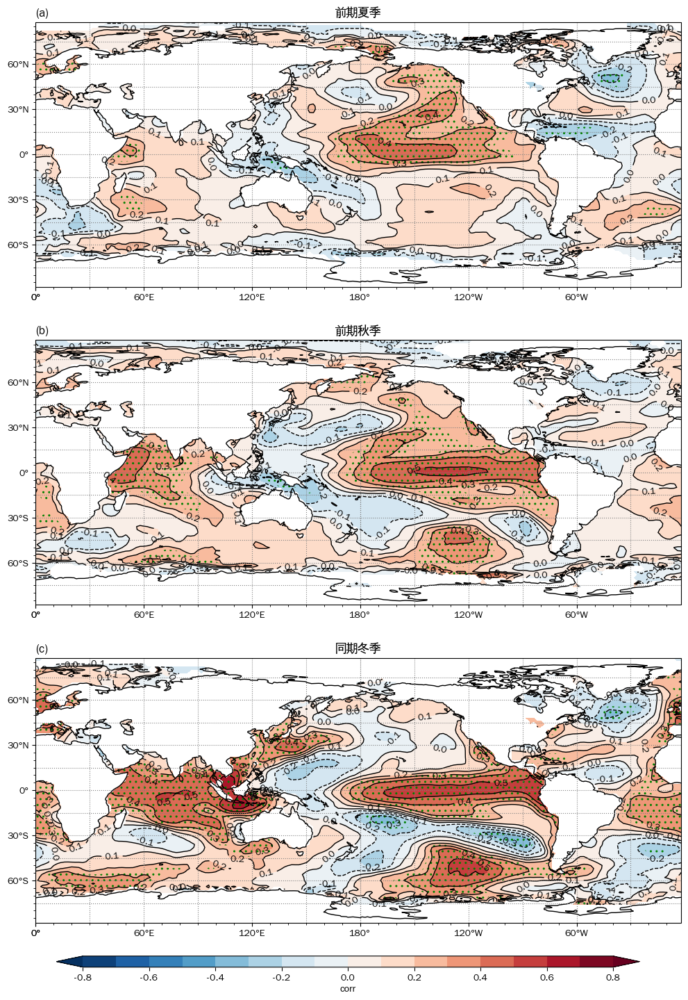

In [ ]:
fig = plt.figure(figsize=[12,16])
ax = fig.add_subplot(311, projection=ccrs.PlateCarree(central_longitude=180))
comset(ax)
m = ax.contourf(sst.lon,sst.lat,linj.corr,transform=ccrs.PlateCarree(), cmap='RdBu_r',
                levels=np.arange(-0.8,0.801,0.1),extend='both'
               )
c = ax.contour(sst.lon,sst.lat,linj.corr,transform=ccrs.PlateCarree(),
               levels=np.arange(-0.8,0.801,0.1),colors='k',linewidths=1
              )
# cb = plt.colorbar(m)
ax.clabel(c)
ax.sig_plot(sst.lon,sst.lat,linj.p_value, thrshd=0.05, marker='..', color='green')
ax.set_title('前期夏季')
ax.set_title('(a)',loc='left')

ax = fig.add_subplot(312, projection=ccrs.PlateCarree(central_longitude=180))
comset(ax)
m = ax.contourf(sst.lon,sst.lat,lins.corr,transform=ccrs.PlateCarree(), cmap='RdBu_r',
                levels=np.arange(-0.8,0.801,0.1),extend='both'
               )
c = ax.contour(sst.lon,sst.lat,lins.corr,transform=ccrs.PlateCarree(),
               levels=np.arange(-0.8,0.801,0.1),colors='k',linewidths=1
              )
# cb = plt.colorbar(m)
ax.clabel(c)
ax.sig_plot(sst.lon,sst.lat,lins.p_value, thrshd=0.05, marker='..', color='green')
ax.set_title('前期秋季')
ax.set_title('(b)',loc='left')

ax = fig.add_subplot(313, projection=ccrs.PlateCarree(central_longitude=180))
comset(ax)
m = ax.contourf(sst.lon,sst.lat,lind.corr,transform=ccrs.PlateCarree(), cmap='RdBu_r',
                levels=np.arange(-0.8,0.801,0.1),extend='both'
               )
c = ax.contour(sst.lon,sst.lat,lind.corr,transform=ccrs.PlateCarree(),
               levels=np.arange(-0.8,0.801,0.1),colors='k',linewidths=1
              )
# cb = plt.colorbar(m)
ax.clabel(c)
ax.sig_plot(sst.lon,sst.lat,lind.p_value, thrshd=0.05, marker='..', color='green')
ax.set_title('同期冬季')
ax.set_title('(c)',loc='left')

fig.subplots_adjust(bottom=0.07)
cbar_ax = fig.add_axes([0.15, 0.03, 0.7, 0.01])
cb = fig.colorbar(m, cax=cbar_ax, orientation='horizontal')
cb.set_label('corr')


## Nino指数

In [29]:
nino34j = sstja.loc[:,5:-5,190:240].mean(('lat','lon'))
nino34s = sstsa.loc[:,5:-5,190:240].mean(('lat','lon'))
nino34d = sstda.loc[:,5:-5,190:240].mean(('lat','lon'))

In [30]:
wnp1d = sstda.loc[:,35:25,130:140].mean(('lat','lon'))
ido1d = sstda.loc[:,5:-5,60:90].mean(('lat','lon'))

In [31]:
mc1d = sstda.loc[:,15:-15,100:120].mean(('lat','lon'))

In [ ]:
stats.pearsonr(scwpi,wnp1d), stats.pearsonr(scwpi,ido1d), stats.pearsonr(scwpi,mc1d)

(PearsonRResult(statistic=0.3998319748408279, pvalue=0.0011679789542121822),
 PearsonRResult(statistic=0.4838162169921339, pvalue=5.891053983163366e-05),
 PearsonRResult(statistic=0.5805088784242787, pvalue=6.128750691089937e-07))

In [33]:
nino34di = nino34d/nino34d.std()
wnp1di = wnp1d/wnp1d.std()
ido1di = ido1d/ido1d.std()
mc1di = mc1d/mc1d.std()

In [41]:
stats.pearsonr(scwpi,nino34di).stat

AttributeError: 'PearsonRResult' object has no attribute 'stats'

In [ ]:
nino34d / nino34di

<xarray.DataArray 'sst' (time: 63)>
array([1.04298735, 1.04298735, 1.04298735, 1.04298735, 1.04298735,
       1.04298735, 1.04298735, 1.04298735, 1.04298735, 1.04298735,
       1.04298735, 1.04298735, 1.04298735, 1.04298735, 1.04298735,
       1.04298735, 1.04298735, 1.04298735, 1.04298735, 1.04298735,
       1.04298735, 1.04298735, 1.04298735, 1.04298735, 1.04298735,
       1.04298735, 1.04298735, 1.04298735, 1.04298735, 1.04298735,
       1.04298735, 1.04298735, 1.04298735, 1.04298735, 1.04298735,
       1.04298735, 1.04298735, 1.04298735, 1.04298735, 1.04298735,
       1.04298735, 1.04298735, 1.04298735, 1.04298735, 1.04298735,
       1.04298735, 1.04298735, 1.04298735, 1.04298735, 1.04298735,
       1.04298735, 1.04298735, 1.04298735, 1.04298735, 1.04298735,
       1.04298735, 1.04298735, 1.04298735, 1.04298735, 1.04298735,
       1.04298735, 1.04298735, 1.04298735])
Coordinates:
  * time     (time) int64 1960 1961 1962 1963 1964 ... 2018 2019 2020 2021 2022

In [ ]:
from scipy

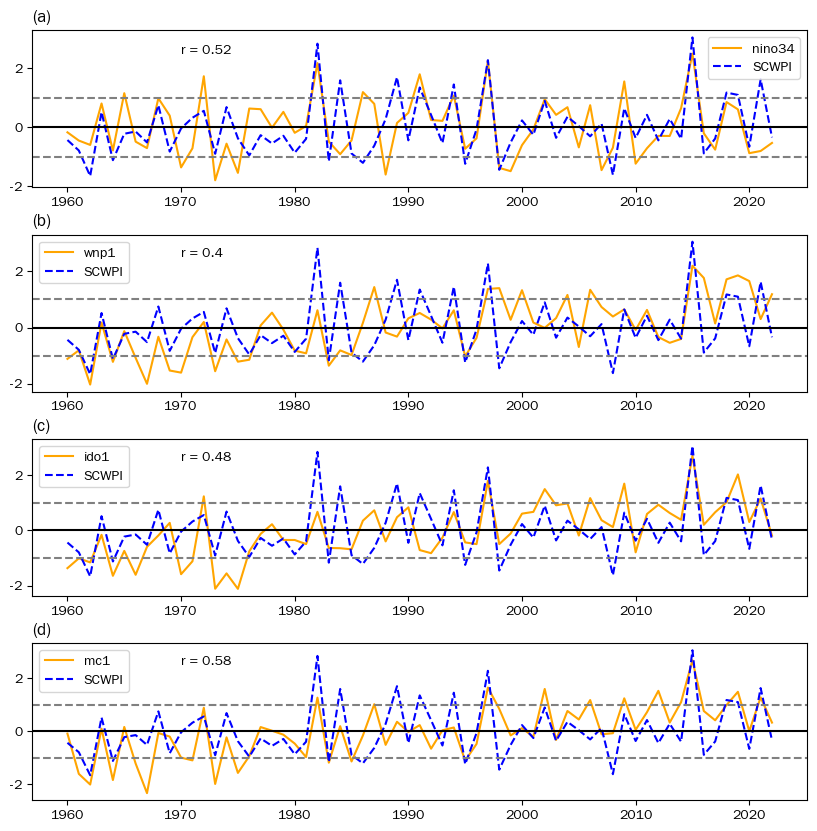

In [47]:
fig=plt.figure(figsize=[10,10])
ax = fig.add_subplot(411)
ax.plot(scwpi.time, nino34di, color='orange', label='nino34')
ax.plot(scwpi.time, scwpi, 'b', linestyle='--', label='SCWPI')
ax.axhline(y=0, color='black', linestyle='-')
ax.axhline(y=1, color='gray', linestyle='--')
ax.axhline(y=-1, color='gray', linestyle='--')
ax.legend()
ax.set_title('(a)', loc='left')
ax.text(1970,2.5,f'r = {scp.LinReg(x=nino34di, y=scwpi).corr:.2}')

ax = fig.add_subplot(412)
ax.plot(scwpi.time, wnp1di, color='orange', label='wnp1')
ax.plot(scwpi.time, scwpi, 'b', linestyle='--', label='SCWPI')
ax.axhline(y=0, color='black', linestyle='-')
ax.axhline(y=1, color='gray', linestyle='--')
ax.axhline(y=-1, color='gray', linestyle='--')
ax.legend()
ax.text(1970,2.5,f'r = {scp.LinReg(x=wnp1di, y=scwpi).corr:.2}')
ax.set_title('(b)', loc='left')

ax = fig.add_subplot(413)
ax.plot(scwpi.time, ido1di, color='orange', label='ido1')
ax.plot(scwpi.time, scwpi, 'b', linestyle='--', label='SCWPI')
ax.axhline(y=0, color='black', linestyle='-')
ax.axhline(y=1, color='gray', linestyle='--')
ax.axhline(y=-1, color='gray', linestyle='--')
ax.legend()
plt.text(1970,2.5,f'r = {scp.LinReg(x=ido1di, y=scwpi).corr:.2}')
ax.set_title('(c)', loc='left')
ax = fig.add_subplot(414)
ax.plot(scwpi.time, mc1di, color='orange', label='mc1')
ax.plot(scwpi.time, scwpi, 'b', linestyle='--', label='SCWPI')
ax.axhline(y=0, color='black', linestyle='-')
ax.axhline(y=1, color='gray', linestyle='--')
ax.axhline(y=-1, color='gray', linestyle='--')
ax.legend()
ax.text(1970,2.5,f'r = {scp.LinReg(x=mc1di, y=scwpi).corr:.2}')
ax.set_title('(d)', loc='left')
fig.subplots_adjust(hspace=0.3)

In [ ]:
sstja.loc[:,5:-5,190:240]

<xarray.DataArray 'sst' (time: 63, lat: 5, lon: 26)>
array([[[-0.36836815, -0.31035423, -0.25434875, ..., -0.09157181,
         -0.150074  , -0.20031738],
        [-0.42015076, -0.3610325 , -0.30259895, ..., -0.19590187,
         -0.249012  , -0.29478645],
        [-0.5086193 , -0.4478283 , -0.38827896, ..., -0.24763107,
         -0.2908764 , -0.32936668],
        [-0.5400543 , -0.48623657, -0.4335518 , ..., -0.21339035,
         -0.24759102, -0.28593636],
        [-0.5143986 , -0.47922325, -0.41180038, ..., -0.05964661,
         -0.08884811, -0.12016678]],

       [[-0.23330688, -0.15820122, -0.08987808, ..., -0.36823082,
         -0.4198265 , -0.46541595],
        [-0.27387047, -0.17375374, -0.09141159, ..., -0.4873619 ,
         -0.5501232 , -0.6117649 ],
        [-0.34501457, -0.23754692, -0.15023994, ..., -0.56916237,
         -0.62293434, -0.6853218 ],
        [-0.4245968 , -0.32959557, -0.2526455 , ..., -0.55008316,
         -0.5878811 , -0.6413784 ],
        [-0.46316338, -0.40369225, -0.3204136 , ..., -0.47714424,
...
         -0.1939106 , -0.19431305],
        [ 0.02031136,  0.01021385,  0.00243378, ..., -0.2965355 ,
         -0.28396797, -0.26820183],
        [-0.03415871, -0.0492363 , -0.05981827, ..., -0.34718323,
         -0.34154892, -0.32409096],
        [-0.06686592, -0.08565521, -0.10158348, ..., -0.3529129 ,
         -0.35111046, -0.33724022],
        [-0.06384468, -0.08497429, -0.10371399, ..., -0.3284893 ,
         -0.30711174, -0.2938671 ]],

       [[-0.64343643, -0.59565544, -0.558794  , ..., -0.33473587,
         -0.30482674, -0.28665733],
        [-0.8248215 , -0.747097  , -0.69839096, ..., -0.39409065,
         -0.37815666, -0.3594799 ],
        [-0.9038429 , -0.820734  , -0.7700367 , ..., -0.4714775 ,
         -0.4628315 , -0.44316483],
        [-0.86019325, -0.79473686, -0.75473595, ..., -0.58369637,
         -0.5739136 , -0.5564556 ],
        [-0.72625923, -0.6900158 , -0.664608  , ..., -0.6782322 ,
         -0.67069626, -0.6599922 ]]], dtype=float32)
Coordinates:
  * lat      (lat) float32 4.0 2.0 0.0 -2.0 -4.0
  * lon      (lon) float32 190.0 192.0 194.0 196.0 ... 234.0 236.0 238.0 240.0
  * time     (time) int64 1960 1961 1962 1963 1964 ... 2018 2019 2020 2021 2022

In [ ]:
stats.pearsonr(scwpi,nino34j)

PearsonRResult(statistic=0.4389990438132715, pvalue=0.00031915556850936724)

In [ ]:
stats.pearsonr(scwpi,nino34s)

PearsonRResult(statistic=0.4993926119881162, pvalue=3.0929323288265666e-05)

In [ ]:
stats.pearsonr(scwpi,nino34d)

PearsonRResult(statistic=0.5229577290515205, pvalue=1.0971148223785209e-05)

In [ ]:
scp.LinReg(x=nino34d, y=scwpi).corr, scp.LinReg(x=nino34d, y=scwpi).p_value

(<xarray.DataArray ()>
 array(0.52295779),
 <xarray.DataArray ()>
 array(1.09733474e-05))

# 合成850hPa 风场

In [ ]:
u850 = xr.open_dataset('uwnd.mon.mean.nc')['uwnd'].loc['1960':'2023',850]
v850 = xr.open_dataset('vwnd.mon.mean.nc')['vwnd'].loc['1960':'2023',850]

u850d = scp.spec_moth_yrmean(u850,months=[12,1,2])
u850d_hm = u850d[u850d.time.isin(prdsc_hyr)].mean('time')
u850d_lm = u850d[u850d.time.isin(prdsc_lyr)].mean('time')
u850da = u850d - u850d.mean('time')
u850da_hm, u850da_hp = scp.one_mean_test(u850da[u850da.time.isin(prdsc_hyr)])
u850da_lm, u850da_lp = scp.one_mean_test(u850da[u850da.time.isin(prdsc_lyr)])

v850d = scp.spec_moth_yrmean(v850,months=[12,1,2])
v850d_hm = v850d[v850d.time.isin(prdsc_hyr)].mean('time')
v850d_lm = v850d[v850d.time.isin(prdsc_lyr)].mean('time')
v850da = v850d - v850d.mean('time')
v850da_hm, v850da_hp = scp.one_mean_test(v850da[v850da.time.isin(prdsc_hyr)])
v850da_lm, v850da_lp = scp.one_mean_test(v850da[v850da.time.isin(prdsc_lyr)])

In [ ]:
wspd850h = np.sqrt(u850d_hm**2 + v850d_hm**2)
wspd850l = np.sqrt(u850d_lm**2 + v850d_lm**2)
wspd850ha = np.sqrt(u850da_hm**2 + v850da_hm**2)
wspd850la = np.sqrt(u850da_lm**2 + v850da_lm**2)

/usr/local/lib/python3.10/site-packages/cartopy/crs.py:529: UserWarning: Some vectors at source domain corners may not have been transformed correctly
  warnings.warn('Some vectors at source domain corners '
/usr/local/lib/python3.10/site-packages/cartopy/crs.py:529: UserWarning: Some vectors at source domain corners may not have been transformed correctly
  warnings.warn('Some vectors at source domain corners '
/usr/local/lib/python3.10/site-packages/cartopy/crs.py:529: UserWarning: Some vectors at source domain corners may not have been transformed correctly
  warnings.warn('Some vectors at source domain corners '


Text(0.5, 1.0, 'WindA Mean in PRSC low years')

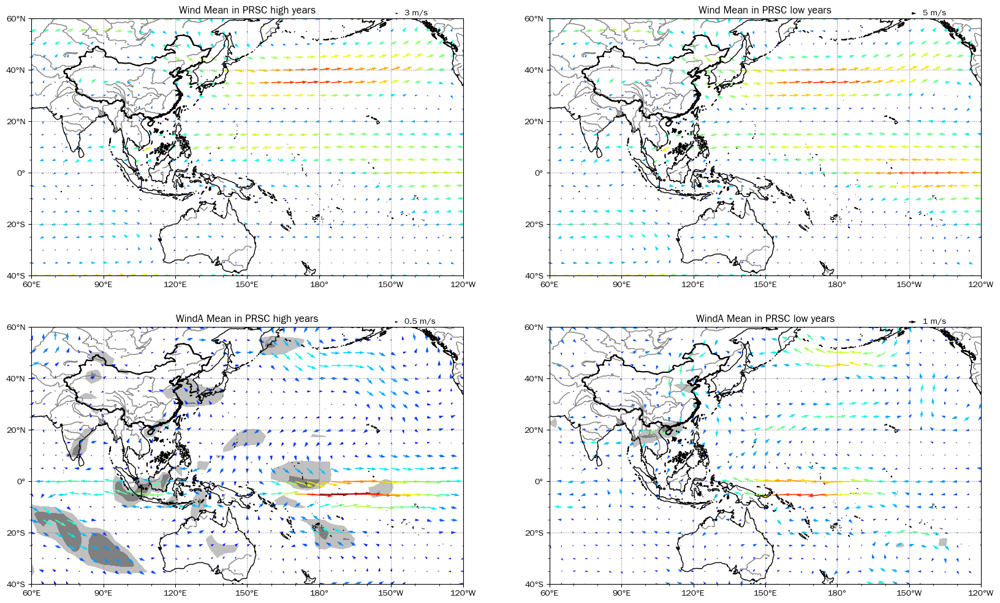

In [ ]:
# fig = plt.figure(figsize=[20,12])
# ax = fig.add_subplot(221, projection=ccrs.PlateCarree(central_longitude=180))
# comset2(ax)
# q = ax.quiver(u850.lon[::2],u850.lat[::2],u850d_hm[::2,::2].to_numpy(),v850d_hm[::2,::2].to_numpy(),wspd850h[::2,::2].to_numpy(),transform=ccrs.PlateCarree(),
#             cmap='jet')
# ax.quiverkey(q, 0.85, 1.02, 3, '3 m/s', labelpos='E'
#             # ,fontproperties={'size':20}
#             )
# ax.set_title('Wind Mean in PRSC high years'
#                 # ,fontsize=27
#                 )

# ax = fig.add_subplot(222, projection=ccrs.PlateCarree(central_longitude=180))
# comset2(ax)
# q = ax.quiver(u850.lon[::2],u850.lat[::2],u850d_lm[::2,::2].to_numpy(),v850d_lm[::2,::2].to_numpy(),wspd850l[::2,::2].to_numpy(),transform=ccrs.PlateCarree(),
#             cmap='jet')
# ax.quiverkey(q, 0.85, 1.02, 5, '5 m/s', labelpos='E'
#             # ,fontproperties={'size':20}
#             )
# ax.set_title('Wind Mean in PRSC low years'
#         # ,fontsize=27
#         )

# ax = fig.add_subplot(223, projection=ccrs.PlateCarree(central_longitude=180))
# comset2(ax)
# ax.contourf(u850da.lon,u850da.lat,np.maximum(u850da_hp,v850da_hp),transform=ccrs.PlateCarree(), 
#             levels=[0,0.05,0.15,1],colors=['grey','silver',(0,0,0,0)])
# q = ax.quiver(u850da.lon[::2],u850da.lat[::2],u850da_hm[::2,::2],v850da_hm[::2,::2],wspd850ha[::2,::2],transform=ccrs.PlateCarree(),
#         cmap='jet')
# ax.quiverkey(q, 0.85, 1.02, 0.5, '0.5 m/s', labelpos='E'
#             # ,fontproperties={'size':20}
#             )
# ax.set_title('WindA Mean in PRSC high years',
#             # fontsize=27
#             )

# ax = fig.add_subplot(224, projection=ccrs.PlateCarree(central_longitude=180))
# comset2(ax)
# ax.contourf(u850da.lon,u850da.lat,np.maximum(u850da_lp,v850da_lp),transform=ccrs.PlateCarree(), 
#             levels=[0,0.05,0.15,1],colors=['grey','silver',(0,0,0,0)])
# q = ax.quiver(u850da.lon[::2],u850da.lat[::2],u850da_lm[::2,::2],v850da_lm[::2,::2],wspd850la[::2,::2],transform=ccrs.PlateCarree(),
#         cmap='jet')
# ax.quiverkey(q, 0.85, 1.02, 1, '1 m/s', labelpos='E',
#             # fontproperties={'size':20}
#             )

# ax.set_title('WindA Mean in PRSC low years',
#             # fontsize=27
#             )

/usr/local/lib/python3.10/site-packages/cartopy/crs.py:529: UserWarning: Some vectors at source domain corners may not have been transformed correctly
  warnings.warn('Some vectors at source domain corners '


Text(0.5, 1.0, 'Wind Mean in PRSC high years')

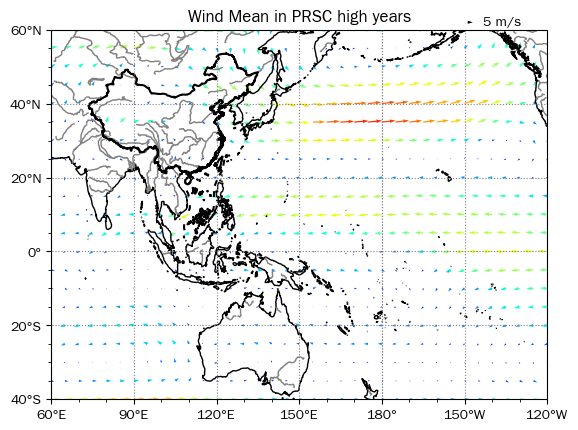

In [ ]:
# fig = plt.figure()
# ax = fig.add_subplot(111, projection=ccrs.PlateCarree(central_longitude=180))
# comset2(ax)
# q = ax.quiver(u850.lon[::2],u850.lat[::2],u850d_hm[::2,::2].to_numpy(),v850d_hm[::2,::2].to_numpy(),wspd850h[::2,::2].to_numpy(),transform=ccrs.PlateCarree(),
#             minlength=0.5,
#             cmap='jet')
# ax.quiverkey(q, 0.85, 1.02, 5, '5 m/s', labelpos='E'
#             # ,fontproperties={'size':20}
#             )
# ax.set_title('Wind Mean in PRSC high years'
#                 # ,fontsize=27
#                 )

/usr/local/lib/python3.10/site-packages/cartopy/crs.py:529: UserWarning: Some vectors at source domain corners may not have been transformed correctly
  warnings.warn('Some vectors at source domain corners '


Text(0.5, 1.0, 'Wind Mean in PRSC high years')

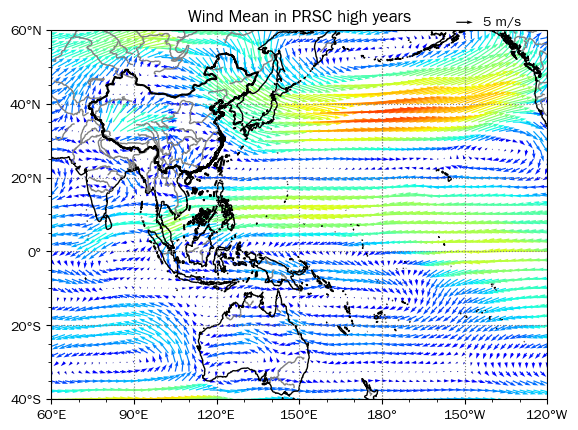

In [ ]:
# fig = plt.figure()
# ax = fig.add_subplot(111, projection=ccrs.PlateCarree(central_longitude=180))
# comset2(ax)
# q = ax.quiver(u850.lon[::1],u850.lat[::1],u850d_hm[::1,::1].to_numpy(),v850d_hm[::1,::1].to_numpy(),wspd850h[::1,::1].to_numpy(),transform=ccrs.PlateCarree(),
#             # minlength=0.5,
#             scale = 150,
#             cmap='jet')
# ax.quiverkey(q, 0.85, 1.02, 5, '5 m/s', labelpos='E'
#             # ,fontproperties={'size':20}
#             )
# ax.set_title('Wind Mean in PRSC high years'
#                 # ,fontsize=27
#                 )

/usr/local/lib/python3.10/site-packages/cartopy/crs.py:529: UserWarning: Some vectors at source domain corners may not have been transformed correctly
  warnings.warn('Some vectors at source domain corners '
/usr/local/lib/python3.10/site-packages/cartopy/crs.py:529: UserWarning: Some vectors at source domain corners may not have been transformed correctly
  warnings.warn('Some vectors at source domain corners '
/usr/local/lib/python3.10/site-packages/cartopy/crs.py:529: UserWarning: Some vectors at source domain corners may not have been transformed correctly
  warnings.warn('Some vectors at source domain corners '


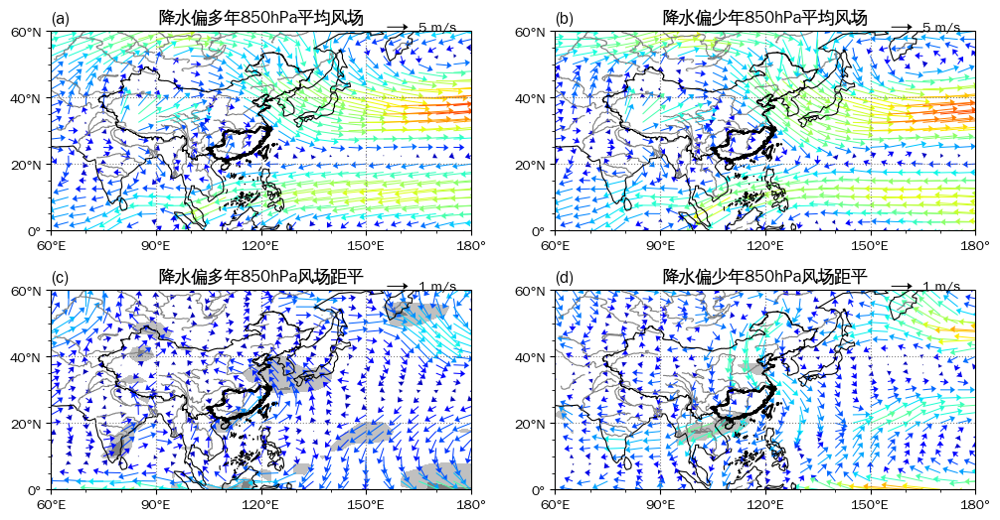

In [ ]:
fig = plt.figure(figsize=[12,6])
ax = fig.add_subplot(221, projection=ccrs.PlateCarree(central_longitude=180))
comset3(ax)
q = ax.quiver(u850.lon[::2],u850.lat[::1],u850d_hm[::1,::2].to_numpy(),v850d_hm[::1,::2].to_numpy(),wspd850h[::1,::2].to_numpy(),transform=ccrs.PlateCarree(),
            scale = 100,cmap='jet',headwidth=7)
ax.quiverkey(q, 0.85, 1.02, 5, '5 m/s', labelpos='E'
            # ,fontproperties={'size':20}
            )
ax.set_title('降水偏多年850hPa平均风场'
                # ,fontsize=27
                )
ax.set_title('(a)',loc='left')

ax = fig.add_subplot(222, projection=ccrs.PlateCarree(central_longitude=180))
comset3(ax)
q = ax.quiver(u850.lon[::2],u850.lat[::1],u850d_lm[::1,::2].to_numpy(),v850d_lm[::1,::2].to_numpy(),wspd850l[::1,::2].to_numpy(),transform=ccrs.PlateCarree(),
            scale = 100,cmap='jet',headwidth=7)
ax.quiverkey(q, 0.85, 1.02, 5, '5 m/s', labelpos='E'
            # ,fontproperties={'size':20}
            )
ax.set_title('降水偏少年850hPa平均风场'
        # ,fontsize=27
        )
ax.set_title('(b)',loc='left')

ax = fig.add_subplot(223, projection=ccrs.PlateCarree(central_longitude=180))
comset3(ax)
ax.contourf(u850da.lon,u850da.lat,np.maximum(u850da_hp,v850da_hp),transform=ccrs.PlateCarree(), 
            levels=[0,0.05,0.15,1],colors=['grey','silver',(0,0,0,0)])
q = ax.quiver(u850da.lon[::2],u850da.lat[::1],u850da_hm[::1,::2],v850da_hm[::1,::2],wspd850ha[::1,::2],transform=ccrs.PlateCarree(),
        scale = 20,cmap='jet',headwidth=7)
ax.quiverkey(q, 0.85, 1.02, 1, '1 m/s', labelpos='E'
            # ,fontproperties={'size':20}
            )
ax.set_title('降水偏多年850hPa风场距平',
            # fontsize=27
            )
ax.set_title('(c)',loc='left')

ax = fig.add_subplot(224, projection=ccrs.PlateCarree(central_longitude=180))
comset3(ax)
ax.contourf(u850da.lon,u850da.lat,np.maximum(u850da_lp,v850da_lp),transform=ccrs.PlateCarree(), 
            levels=[0,0.05,0.15,1],colors=['grey','silver',(0,0,0,0)])
q = ax.quiver(u850da.lon[::2],u850da.lat[::1],u850da_lm[::1,::2],v850da_lm[::1,::2],wspd850la[::1,::2],transform=ccrs.PlateCarree(),
        scale = 20,cmap='jet',headwidth=7)
ax.quiverkey(q, 0.85, 1.02, 1, '1 m/s', labelpos='E',
            # fontproperties={'size':20}
            )
ax.set_title('降水偏少年850hPa风场距平',
            # fontsize=27
            )
ax.set_title('(d)',loc='left')

fig.subplots_adjust(hspace=0.3)

# 200hPa 风场

In [ ]:
u200 = xr.open_dataset('uwnd.mon.mean.nc')['uwnd'].loc['1960':'2023',200]
v200 = xr.open_dataset('vwnd.mon.mean.nc')['vwnd'].loc['1960':'2023',200]

u200d = scp.spec_moth_yrmean(u200,months=[12,1,2])
u200d_hm = u200d[u200d.time.isin(prdsc_hyr)].mean('time')
u200d_lm = u200d[u200d.time.isin(prdsc_lyr)].mean('time')
u200da = u200d - u200d.mean('time')
u200da_hm, u200da_hp = scp.one_mean_test(u200da[u200da.time.isin(prdsc_hyr)])
u200da_lm, u200da_lp = scp.one_mean_test(u200da[u200da.time.isin(prdsc_lyr)])

v200d = scp.spec_moth_yrmean(v200,months=[12,1,2])
v200d_hm = v200d[v200d.time.isin(prdsc_hyr)].mean('time')
v200d_lm = v200d[v200d.time.isin(prdsc_lyr)].mean('time')
v200da = v200d - v200d.mean('time')
v200da_hm, v200da_hp = scp.one_mean_test(v200da[v200da.time.isin(prdsc_hyr)])
v200da_lm, v200da_lp = scp.one_mean_test(v200da[v200da.time.isin(prdsc_lyr)])

In [ ]:
wspd200h = np.sqrt(u200d_hm**2 + v200d_hm**2)
wspd200l = np.sqrt(u200d_lm**2 + v200d_lm**2)
wspd200ha = np.sqrt(u200da_hm**2 + v200da_hm**2)
wspd200la = np.sqrt(u200da_lm**2 + v200da_lm**2)

In [ ]:
u200d_hm.quantile([0,0.25,0.5,0.75,1]), np.quantile(u200da_hm,[0,0.25,0.5,0.75,1])
# u850d_hm.quantile([0,0.25,0.5,0.75,1])

(<xarray.DataArray 'uwnd' (quantile: 5)>
 array([-10.78749657,   3.97521949,  13.48183584,  23.02317429,
         72.74893188])
 Coordinates:
   * quantile  (quantile) float64 0.0 0.25 0.5 0.75 1.0,
 array([-5.93664932, -0.40917867,  0.37986654,  1.36753261,  5.22890377]))

/usr/local/lib/python3.10/site-packages/cartopy/crs.py:529: UserWarning: Some vectors at source domain corners may not have been transformed correctly
  warnings.warn('Some vectors at source domain corners '
/usr/local/lib/python3.10/site-packages/cartopy/crs.py:529: UserWarning: Some vectors at source domain corners may not have been transformed correctly
  warnings.warn('Some vectors at source domain corners '
/usr/local/lib/python3.10/site-packages/cartopy/crs.py:529: UserWarning: Some vectors at source domain corners may not have been transformed correctly
  warnings.warn('Some vectors at source domain corners '


Text(0.5, 1.0, '降水偏少年200hPa平均风场距平')

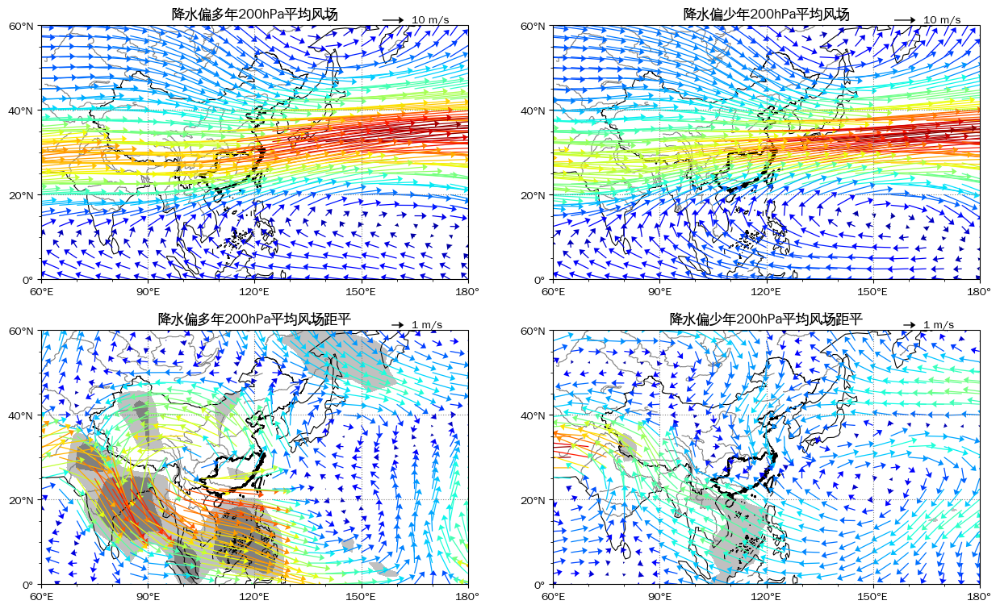

In [ ]:
fig = plt.figure(figsize=[15,9])
ax = fig.add_subplot(221, projection=ccrs.PlateCarree(central_longitude=180))
comset3(ax)
q = ax.quiver(u200.lon[::2],u200.lat[::1],u200d_hm[::1,::2].to_numpy(),v200d_hm[::1,::2].to_numpy(),wspd200h[::1,::2].to_numpy(),transform=ccrs.PlateCarree(),
            scale = 200,headwidth=7,zorder=2,cmap='jet')
ax.quiverkey(q, 0.85, 1.02, 10, '10 m/s', labelpos='E'
            # ,fontproperties={'size':20}
            )
ax.set_title('降水偏多年200hPa平均风场')

ax = fig.add_subplot(222, projection=ccrs.PlateCarree(central_longitude=180))
comset3(ax)
q = ax.quiver(u200.lon[::2],u200.lat[::1],u200d_lm[::1,::2].to_numpy(),v200d_lm[::1,::2].to_numpy(),wspd200l[::1,::2].to_numpy(),transform=ccrs.PlateCarree(),
            scale = 200,headwidth=7,zorder=2,cmap='jet')
ax.quiverkey(q, 0.85, 1.02, 10, '10 m/s', labelpos='E'
            # ,fontproperties={'size':20}
            )
ax.set_title('降水偏少年200hPa平均风场')

ax = fig.add_subplot(223, projection=ccrs.PlateCarree(central_longitude=180))
comset3(ax)
ax.contourf(u200da.lon,u200da.lat,np.maximum(u200da_hp,v200da_hp),transform=ccrs.PlateCarree(), 
            levels=[0,0.05,0.15,1],colors=['grey','silver',(0,0,0,0)])
q = ax.quiver(u200da.lon[::2],u200da.lat[::1],u200da_hm[::1,::2],v200da_hm[::1,::2],wspd200ha[::1,::2],transform=ccrs.PlateCarree(),
        scale = 35,headwidth=7,zorder=2,cmap='jet')
ax.quiverkey(q, 0.85, 1.02, 1, '1 m/s', labelpos='E'
            # ,fontproperties={'size':20}
            )
ax.set_title('降水偏多年200hPa平均风场距平')

ax = fig.add_subplot(224, projection=ccrs.PlateCarree(central_longitude=180))
comset3(ax)
ax.contourf(u200da.lon,u200da.lat,np.maximum(u200da_lp,v200da_lp),transform=ccrs.PlateCarree(), 
            levels=[0,0.05,0.15,1],colors=['grey','silver',(0,0,0,0)])
q = ax.quiver(u200da.lon[::2],u200da.lat[::1],u200da_lm[::1,::2],v200da_lm[::1,::2],wspd200la[::1,::2],transform=ccrs.PlateCarree(),
        scale = 35,headwidth=7,zorder=2,cmap='jet')
ax.quiverkey(q, 0.85, 1.02, 1, '1 m/s', labelpos='E',
            # fontproperties={'size':20}
            )
ax.set_title('降水偏少年200hPa平均风场距平')

## 纬向风

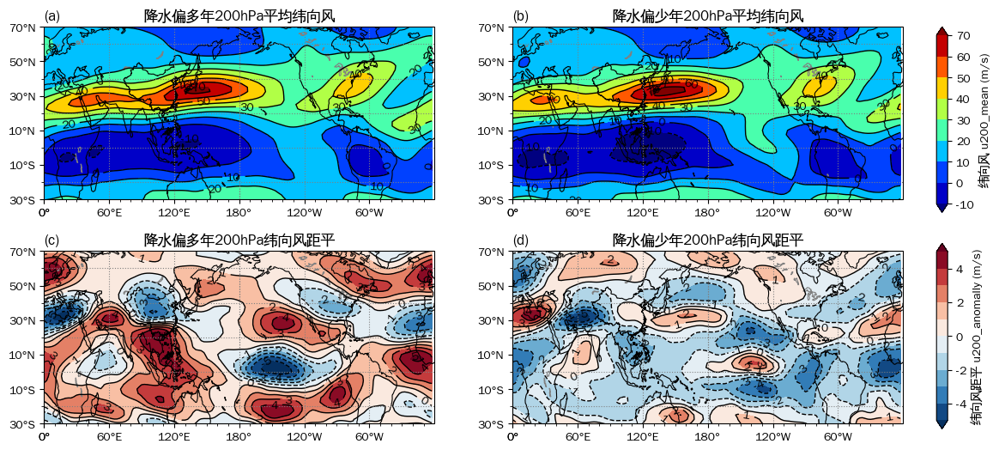

In [ ]:
fig = plt.figure(figsize=[13,6])
ax1 = fig.add_subplot(221, projection=ccrs.PlateCarree(central_longitude=180))
comset4(ax1)
# c1 = ax1.contour(u200.lon,u200.lat,u200d_hm,transform=ccrs.PlateCarree(),levels=np.arange(-10,71,10))
m1 = ax1.contourf(u200.lon,u200.lat,u200d_hm,transform=ccrs.PlateCarree(),levels=np.arange(-10,71,10),extend='both',cmap='jet')
c1 = ax1.contour(u200.lon,u200.lat,u200d_hm,transform=ccrs.PlateCarree(),levels=np.arange(-10,71,10),colors='k',linewidths=1)
ax1.clabel(c1)
ax1.set_title('降水偏多年200hPa平均纬向风')
ax1.set_title('(a)',loc='left')

ax2 = fig.add_subplot(222, projection=ccrs.PlateCarree(central_longitude=180))
comset4(ax2)
m2 = ax2.contourf(u200.lon,u200.lat,u200d_lm,transform=ccrs.PlateCarree(),levels=np.arange(-10,71,10),extend='both',cmap='jet')
c2 = ax2.contour(u200.lon,u200.lat,u200d_lm,transform=ccrs.PlateCarree(),levels=np.arange(-10,71,10),colors='k',linewidths=1)
ax2.clabel(c2)
ax2.set_title('降水偏少年200hPa平均纬向风')
ax2.set_title('(b)',loc='left')

ax3 = fig.add_subplot(223, projection=ccrs.PlateCarree(central_longitude=180))
comset4(ax3)
# ax.contourf(u200da.lon,u200da.lat,np.maximum(u200da_hp,v200da_hp),transform=ccrs.PlateCarree(), 
#             levels=[0,0.05,0.15,1],colors=['grey','silver',(0,0,0,0)])
m3 = ax3.contourf(u200da.lon,u200da.lat,u200da_hm,transform=ccrs.PlateCarree(),levels=np.arange(-5,5.01,1),extend='both',cmap='RdBu_r')
c3 = ax3.contour(u200da.lon,u200da.lat,u200da_hm,transform=ccrs.PlateCarree(),levels=np.arange(-5,5.01,1),colors='k',linewidths=1)
ax3.clabel(c3)
ax3.set_title('降水偏多年200hPa纬向风距平')
ax3.set_title('(c)',loc='left')

ax4 = fig.add_subplot(224, projection=ccrs.PlateCarree(central_longitude=180))
comset4(ax4)
# ax.contourf(u200da.lon,u200da.lat,np.maximum(u200da_lp,v200da_lp),transform=ccrs.PlateCarree(), 
#             levels=[0,0.05,0.15,1],colors=['grey','silver',(0,0,0,0)])
m4 = ax4.contourf(u200da.lon,u200da.lat,u200da_lm,transform=ccrs.PlateCarree(),levels=np.arange(-5,5.01,1),extend='both',cmap='RdBu_r')
c4 = ax4.contour(u200da.lon,u200da.lat,u200da_lm,transform=ccrs.PlateCarree(),levels=np.arange(-5,5.01,1),colors='k',linewidths=1)
ax4.clabel(c4)
ax4.set_title('降水偏少年200hPa纬向风距平')
ax4.set_title('(d)',loc='left')

# subplots_adjust
# cb = plt.colorbar(m)
# cb.set_label('mm/day')
fig.subplots_adjust(left=0.13,hspace=0.3)
cbar1_ax = fig.add_axes([0.93, 0.52, 0.01, 0.36])
cbar3_ax = fig.add_axes([0.93, 0.10, 0.01, 0.36])
cb1 = fig.colorbar(m1, cax=cbar1_ax)
cb3 = fig.colorbar(m3, cax=cbar3_ax)
cb1.set_label('纬向风 u200_mean (m/s)')
cb3.set_label('纬向风距平 u200_anomally (m/s)')

# $\omega$

In [ ]:
xr.open_dataset('omega.mon.mean.nc')

<xarray.Dataset>
Dimensions:  (level: 12, lat: 73, lon: 144, time: 904)
Coordinates:
  * level    (level) float32 1e+03 925.0 850.0 700.0 ... 250.0 200.0 150.0 100.0
  * lat      (lat) float32 90.0 87.5 85.0 82.5 80.0 ... -82.5 -85.0 -87.5 -90.0
  * lon      (lon) float32 0.0 2.5 5.0 7.5 10.0 ... 350.0 352.5 355.0 357.5
  * time     (time) datetime64[ns] 1948-01-01 1948-02-01 ... 2023-04-01
Data variables:
    omega    (time, level, lat, lon) float32 ...
Attributes:
    description:    Data from NCEP initialized reanalysis (4x/day).  These ar...
    platform:       Model
    Conventions:    COARDS
    NCO:            20121012
    history:        Thu May  4 18:09:59 2000: ncrcat -d time,0,622 /Datasets/...
    title:          monthly mean omega from the NCEP Reanalysis
    dataset_title:  NCEP-NCAR Reanalysis 1
    References:     http://www.psl.noaa.gov/data/gridded/data.ncep.reanalysis...

In [ ]:
omega = xr.open_dataset('omega.mon.mean.nc')['omega'].loc[{'time':slice('1960','2023'),'level':500}]
omegad = scp.spec_moth_yrmean(omega,months=[12,1,2])
omegadm = omegad.mean('time')
omegada = omegad - omegadm 
omegad_hm = omegad[omegad.time.isin(prdsc_hyr)].mean('time')
omegad_lm = omegad[omegad.time.isin(prdsc_lyr)].mean('time')
omegada_hm, omegada_hp = scp.one_mean_test(omegada[omegada.time.isin(prdsc_hyr)])
omegada_lm, omegada_lp = scp.one_mean_test(omegada[omegada.time.isin(prdsc_lyr)])

In [ ]:
omegadm.quantile([0,0.25,0.5,0.75,1]), omegada.quantile([0,0.25,0.5,0.75,1])

(<xarray.DataArray 'omega' (quantile: 5)>
 array([-0.08002679, -0.00915225,  0.00088471,  0.01337412,  0.11041173])
 Coordinates:
   * quantile  (quantile) float64 0.0 0.25 0.5 0.75 1.0,
 <xarray.DataArray 'omega' (quantile: 5)>
 array([-0.13094652, -0.00803214,  0.00021991,  0.00832682,  0.10286558])
 Coordinates:
   * quantile  (quantile) float64 0.0 0.25 0.5 0.75 1.0)

/usr/local/lib/python3.10/site-packages/cmaps/cmaps.py:3495: UserWarning: Overwriting the cmap 'NEO_div_vegetation_a_r' that was already in the registry.
  matplotlib.cm.register_cmap(name=cname, cmap=cmap)
/usr/local/lib/python3.10/site-packages/cmaps/cmaps.py:3495: UserWarning: Overwriting the cmap 'NEO_div_vegetation_a_r' that was already in the registry.
  matplotlib.cm.register_cmap(name=cname, cmap=cmap)
/usr/local/lib/python3.10/site-packages/cmaps/cmaps.py:3495: UserWarning: Overwriting the cmap 'NEO_div_vegetation_a_r' that was already in the registry.
  matplotlib.cm.register_cmap(name=cname, cmap=cmap)
/usr/local/lib/python3.10/site-packages/cartopy/io/__init__.py:241: DownloadWarning: Downloading: https://naturalearth.s3.amazonaws.com/110m_physical/ne_110m_rivers_lake_centerlines.zip
  warnings.warn(f'Downloading: {url}', DownloadWarning)


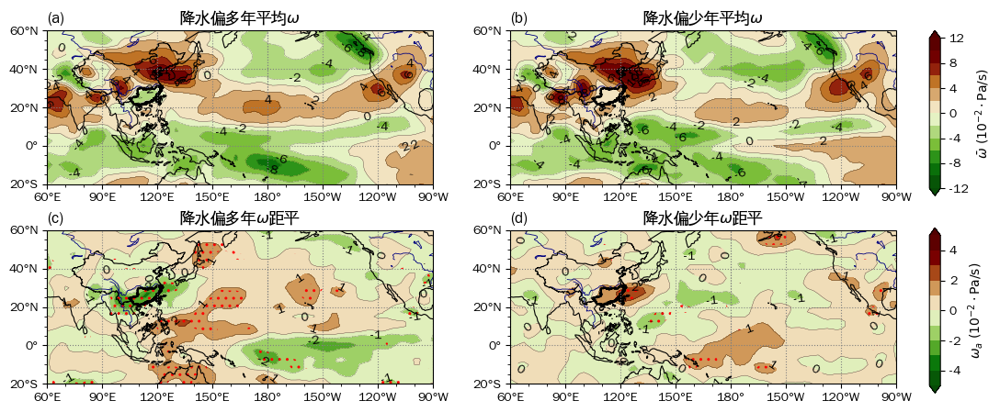

In [ ]:
fig = plt.figure(figsize=[12,5])

ax = fig.add_subplot(221,projection=ccrs.PlateCarree(central_longitude=180))
comset5(ax)
m1 = ax.contourf(omegad.lon,omegad.lat,omegad_hm*10**2,transform=ccrs.PlateCarree(),
                cmap=cmaps.NEO_div_vegetation_a_r,levels=np.arange(-12,12.01,2),extend='both'
                )
c = ax.contour(omegad.lon,omegad.lat,omegad_hm*10**2,transform=ccrs.PlateCarree(),
                levels=np.arange(-12,12.01,2),colors='k',linewidths=0.2
                )
ax.clabel(c)
ax.set_title('降水偏多年平均$\omega$')
ax.set_title('(a)', loc='left')

ax = fig.add_subplot(222,projection=ccrs.PlateCarree(central_longitude=180))
comset5(ax)
m1 = ax.contourf(omegad.lon,omegad.lat,omegad_lm*10**2,transform=ccrs.PlateCarree(),
                cmap=cmaps.NEO_div_vegetation_a_r,levels=np.arange(-12,12.01,2),extend='both'
                )
c = ax.contour(omegad.lon,omegad.lat,omegad_lm*10**2,transform=ccrs.PlateCarree(),
                levels=np.arange(-12,12.01,2),colors='k',linewidths=0.2
                )
ax.clabel(c)
ax.set_title('降水偏少年平均$\omega$')
ax.set_title('(b)', loc='left')

ax = fig.add_subplot(223,projection=ccrs.PlateCarree(central_longitude=180))
comset5(ax)
m2 = ax.contourf(omegad.lon,omegad.lat,omegada_hm*10**2,transform=ccrs.PlateCarree(),
                cmap=cmaps.NEO_div_vegetation_a_r,levels=np.arange(-5,5.01,1),extend='both'
                )
c = ax.contour(omegad.lon,omegad.lat,omegada_hm*10**2,transform=ccrs.PlateCarree(),
                levels=np.arange(-5,5.01,1),colors='k',linewidths=0.2
                )
ax.sig_plot(omegad.lon,omegad.lat,omegada_hp, thrshd=0.05, marker='..', color='red')
ax.clabel(c)
ax.set_title('降水偏多年$\omega$距平')
ax.set_title('(c)', loc='left')

ax = fig.add_subplot(224,projection=ccrs.PlateCarree(central_longitude=180))
comset5(ax)
m2 = ax.contourf(omegad.lon,omegad.lat,omegada_lm*10**2,transform=ccrs.PlateCarree(),
                cmap=cmaps.NEO_div_vegetation_a_r,levels=np.arange(-5,5.01,1),extend='both'
                )
c = ax.contour(omegad.lon,omegad.lat,omegada_lm*10**2,transform=ccrs.PlateCarree(),
                levels=np.arange(-5,5.01,1),colors='k',linewidths=0.2
                )
ax.sig_plot(omegad.lon,omegad.lat,omegada_lp, thrshd=0.05, marker='..', color='red')
ax.clabel(c)
ax.set_title('降水偏少年$\omega$距平')
ax.set_title('(d)', loc='left')

fig.subplots_adjust(left=0.13,hspace=0.3)
cbar1_ax = fig.add_axes([0.93, 0.52, 0.01, 0.36])
cbar2_ax = fig.add_axes([0.93, 0.09, 0.01, 0.36])
cb1 = fig.colorbar(m1, cax=cbar1_ax)
cb2 = fig.colorbar(m2, cax=cbar2_ax)
cb1.set_label(r'$\bar{\omega}\ (10^{-2} \cdot \mathrm{Pa}/\mathrm{s})$')
cb2.set_label(r'$\omega_{a}\ (10^{-2} \cdot \mathrm{Pa}/\mathrm{s})$')

# Snow Test

In [ ]:
xr.open_dataset('weasd.sfc.mon.mean.nc')

<xarray.Dataset>
Dimensions:  (lat: 94, lon: 192, time: 904)
Coordinates:
  * lat      (lat) float32 88.54 86.65 84.75 82.85 ... -84.75 -86.65 -88.54
  * lon      (lon) float32 0.0 1.875 3.75 5.625 7.5 ... 352.5 354.4 356.2 358.1
  * time     (time) datetime64[ns] 1948-01-01 1948-02-01 ... 2023-04-01
Data variables:
    weasd    (time, lat, lon) float32 ...
Attributes:
    Conventions:    COARDS
    description:    Data is from NCEP initialized reanalysis\n(4x/day).  It c...
    platform:       Model
    NCO:            20121013
    history:        Created 2011/06/28 by ESRL/PSD Web & Data Team\nConverted...
    title:          monthly mean weasd.sfc from the NCEP Reanalysis
    dataset_title:  NCEP-NCAR Reanalysis 1
    References:     http://www.psl.noaa.gov/data/gridded/data.ncep.reanalysis...

In [ ]:
asd = xr.open_dataset('weasd.sfc.mon.mean.nc')['weasd'].loc[{'time':slice('1960','2023')}]
asd = xr.where(np.abs(asd)>0.6553,np.nan,asd)
asdd = scp.spec_moth_yrmean(asd,months=[12,1,2])
asddm = asdd.mean('time')
asdda = asdd - asddm
asdd_hm = asdd[asdd.time.isin(prdsc_hyr)].mean('time')
asdd_lm = asdd[asdd.time.isin(prdsc_lyr)].mean('time')
asdda_hm,asdda_hp = scp.one_mean_test(asdda[asdda.time.isin(prdsc_hyr)])
asdda_lm,asdda_lp = scp.one_mean_test(asdda[asdda.time.isin(prdsc_lyr)])

/usr/local/lib/python3.10/site-packages/scipy/stats/_axis_nan_policy.py:554: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  return result_to_tuple(hypotest_fun_out(*samples, **kwds))


In [ ]:
asddm.quantile([0,0.25,0.5,0.75,1]), asdda.quantile([0,0.25,0.5,0.75,1])

(<xarray.DataArray 'weasd' (quantile: 5)>
 array([0.0000000e+00, 0.0000000e+00, 0.0000000e+00, 2.8117486e+01,
        5.4999207e+04])
 Coordinates:
   * quantile  (quantile) float64 0.0 0.25 0.5 0.75 1.0,
 <xarray.DataArray 'weasd' (quantile: 5)>
 array([-22668.578125  ,      0.        ,      0.        ,      0.        ,
         32243.79101562])
 Coordinates:
   * quantile  (quantile) float64 0.0 0.25 0.5 0.75 1.0)

In [ ]:
asdd_hm.quantile([0,0.25,0.5,0.75,0.98,1]), asdda.quantile([0,0.25,0.5,0.75,0.99,1])

(<xarray.DataArray 'weasd' (quantile: 6)>
 array([0.        , 0.        , 0.        , 0.        , 0.00139229,
        0.42916736])
 Coordinates:
   * quantile  (quantile) float64 0.0 0.25 0.5 0.75 0.98 1.0,
 <xarray.DataArray 'weasd' (quantile: 6)>
 array([-0.21077818,  0.        ,  0.        ,  0.        ,  0.        ,
         0.268534  ])
 Coordinates:
   * quantile  (quantile) float64 0.0 0.25 0.5 0.75 0.99 1.0)

/usr/local/lib/python3.10/site-packages/cmaps/cmaps.py:7070: UserWarning: Overwriting the cmap 'wh_bl_gr_ye_re' that was already in the registry.
  matplotlib.cm.register_cmap(name=cname, cmap=cmap)


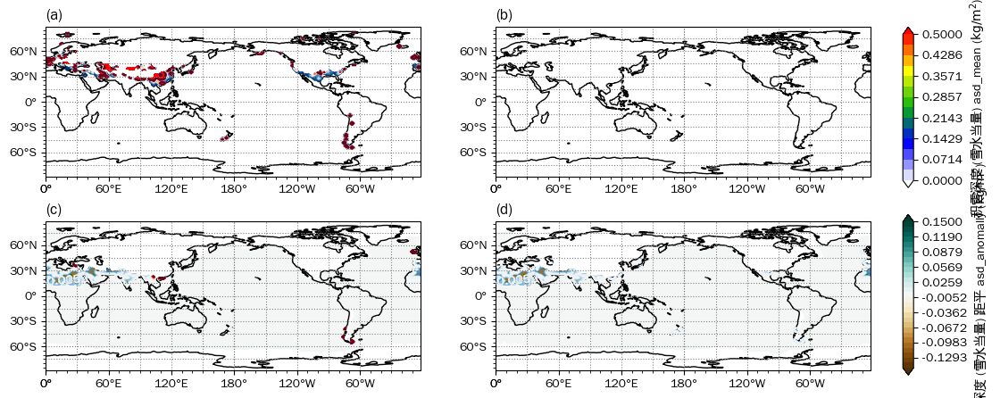

In [ ]:
fig = plt.figure(figsize=[12,5])

ax = fig.add_subplot(221,projection=ccrs.PlateCarree(central_longitude=180))
comset(ax)
m1 = ax.contourf(asdd.lon,asdd.lat,asdd_hm*10**2,transform=ccrs.PlateCarree(),
                cmap=cmaps.wh_bl_gr_ye_re,levels=np.linspace(0,0.5,15),extend='both'
                )
c = ax.contour(asdd.lon,asdd.lat,asdd_hm*10**2,transform=ccrs.PlateCarree(),
                levels=np.linspace(0,0.5,15)
                )
ax.clabel(c)
ax.set_title('(a)', loc='left')

ax = fig.add_subplot(222,projection=ccrs.PlateCarree(central_longitude=180))
comset(ax)
m1 = ax.contourf(asdd.lon,asdd.lat,asdd_lm*10**2,transform=ccrs.PlateCarree(),
                cmap=cmaps.wh_bl_gr_ye_re,levels=np.linspace(0,0.5,15),extend='both'
                )
c = ax.contour(asdd.lon,asdd.lat,asdd_lm*10**2,transform=ccrs.PlateCarree(),
                levels=np.linspace(0,0.5,15)
                )
ax.clabel(c)
ax.set_title('(b)', loc='left')

ax = fig.add_subplot(223,projection=ccrs.PlateCarree(central_longitude=180))
comset(ax)
m2 = ax.contourf(asdd.lon,asdd.lat,asdda_hm*10**2,transform=ccrs.PlateCarree(),
                cmap = 'BrBG',levels=np.linspace(-0.15,0.15,30),extend='both'
                )
c = ax.contour(asdd.lon,asdd.lat,asdda_hm*10**2,transform=ccrs.PlateCarree(),
                levels=np.linspace(-0.15,0.15,30)
                )
ax.sig_plot(asdd.lon,asdd.lat,asdda_hp, thrshd=0.05, marker='..', color='green')
ax.clabel(c)
ax.set_title('(c)', loc='left')

ax = fig.add_subplot(224,projection=ccrs.PlateCarree(central_longitude=180))
comset(ax)
m2 = ax.contourf(asdd.lon,asdd.lat,asdda_lm*10**2,transform=ccrs.PlateCarree(),
                cmap = 'BrBG',levels=np.linspace(-0.15,0.15,30),extend='both'
                )
c = ax.contour(asdd.lon,asdd.lat,asdda_lm*10**2,transform=ccrs.PlateCarree(),
                levels=np.linspace(-0.15,0.15,30)
                )
ax.sig_plot(asdd.lon,asdd.lat,asdda_lp, thrshd=0.05, marker='..', color='green')
ax.clabel(c)
ax.set_title('(d)', loc='left')

fig.subplots_adjust(left=0.13,hspace=0.3)
cbar1_ax = fig.add_axes([0.93, 0.52, 0.01, 0.36])
cbar2_ax = fig.add_axes([0.93, 0.10, 0.01, 0.36])
cb1 = fig.colorbar(m1, cax=cbar1_ax)
cb2 = fig.colorbar(m2, cax=cbar2_ax)
cb1.set_label('积雪深度 (雪水当量) asd_mean ($\mathrm{kg}/\mathrm{m}^2$)')
cb2.set_label('积雪深度 (雪水当量) 距平 asd_anomally ($\mathrm{kg}/\mathrm{m}^2$)')

# DO!!!
- [ ] Nino 3.4指数
- [ ] 东亚冬季风指数、其他指数

# 指数

In [ ]:
df = pd.read_table('Nino34.mon.mean.txt', sep='\s+',names=['year','Nino34'],header=None)

Text(0, 0.5, 'Nino3.4 Index')

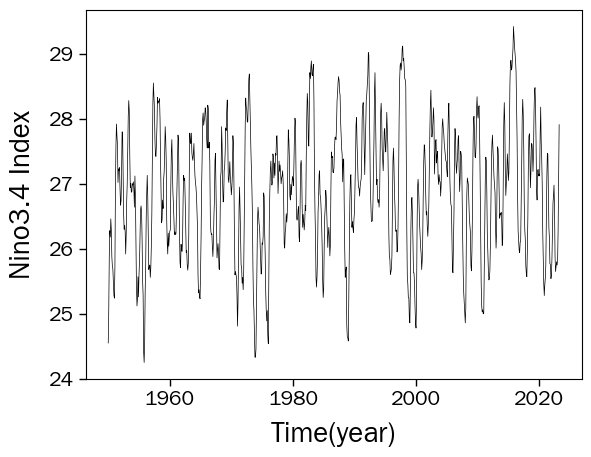

In [ ]:
fig = plt.figure()
ax1 = fig.add_subplot(111)
ax1.plot(df['year'],df['Nino34'], c='k',lw=0.5)
# ax1.set_ylim(-10,10)
ax1.tick_params(axis='x',which='major',direction='out',length=5,width=1,labelsize=15)
ax1.tick_params(axis='y',which='major',direction='out',length=5,width=1,labelsize=15)
ax1.set_xlabel('Time(year)',fontsize=20,labelpad=10)
ax1.set_ylabel('Nino3.4 Index',fontsize=20,labelpad=10)

In [ ]:
nino34_m = []
for i in range(len(df)-2):
    nino34_i = df['Nino34'][i:i+3]
    nino34_m.append(np.mean(nino34_i.values))

Text(0, 0.5, 'Nino34 Index')

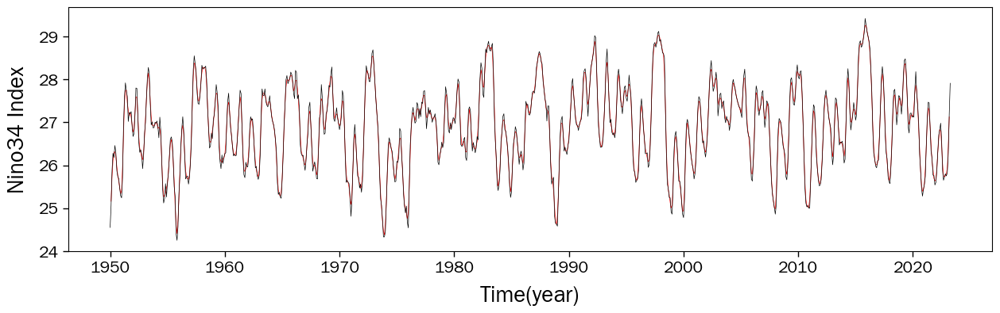

In [ ]:
fig = plt.figure(figsize=[15,4])
ax1 = fig.add_subplot(111)
ax1.plot(df['year'][1:len(df)-1],nino34_m,c='r',lw=0.5)
ax1.plot(df['year'],df['Nino34'],c='k',lw=0.5)
# ax1.set_ylim(-10,10)
ax1.tick_params(axis='x',which='major',direction='out',length=5,width=1,labelsize=15)
ax1.tick_params(axis='y',which='major',direction='out',length=5,width=1,labelsize=15)
ax1.set_xlabel('Time(year)',fontsize=20,labelpad=10)
ax1.set_ylabel('Nino34 Index',fontsize=20,labelpad=10)

## 西伯利亚高压指数 40-60N, 70-120E

In [ ]:
slp = xr.open_dataset('slp.mon.mean.nc')['slp'].loc['1960':'2023']
slpd = scp.spec_moth_yrmean(slp, months=[12,1,2])
slpda = slpd - slpd.mean('time')
slp_gong = (slpda/slpda.std()).loc[{'lat':slice(60,40),'lon':slice(70,120)}].mean(('lat','lon'))

In [ ]:
stats.pearsonr(scwpi,slp_gong)

PearsonRResult(statistic=-0.09684057738916843, pvalue=0.4502290125929195)

## 海-陆气压差指数: 30-55N, 100-120E & 30-55N, 150-170E

In [ ]:
slp_chl = (slpda/slpda.std()).loc[{'lat':slice(55,30),'lon':slice(100,120)}].mean(('lat','lon')) - (slpda/slpda.std()).loc[{'lat':slice(55,30),'lon':slice(150,170)}].mean(('lat','lon'))

In [ ]:
stats.pearsonr(scwpi,slp_chl)

PearsonRResult(statistic=-0.24694555780012778, pvalue=0.051038786470044756)

<a style='text-decoration:none;line-height:16px;display:flex;color:#5B5B62;padding:10px;justify-content:end;' href='https://deepnote.com?utm_source=created-in-deepnote-cell&projectId=971f4ee0-3238-4c75-8630-2ef1e8ea4a4a' target="_blank">
 </img>
Created in <span style='font-weight:600;margin-left:4px;'>Deepnote</span></a>